In [34]:
import Pkg
Pkg.add("DifferentialEquations")
Pkg.add("Turing")
Pkg.add("Distributions")
Pkg.add("StatsPlots")

 Resolving package versions...
  Updating `~/.julia/environments/v1.3/Project.toml`
 [no changes]
  Updating `~/.julia/environments/v1.3/Manifest.toml`
 [no changes]
 Resolving package versions...
  Updating `~/.julia/environments/v1.3/Project.toml`
 [no changes]
  Updating `~/.julia/environments/v1.3/Manifest.toml`
 [no changes]
 Resolving package versions...
  Updating `~/.julia/environments/v1.3/Project.toml`
 [no changes]
  Updating `~/.julia/environments/v1.3/Manifest.toml`
 [no changes]
 Resolving package versions...
  Updating `~/.julia/environments/v1.3/Project.toml`
 [no changes]
  Updating `~/.julia/environments/v1.3/Manifest.toml`
 [no changes]


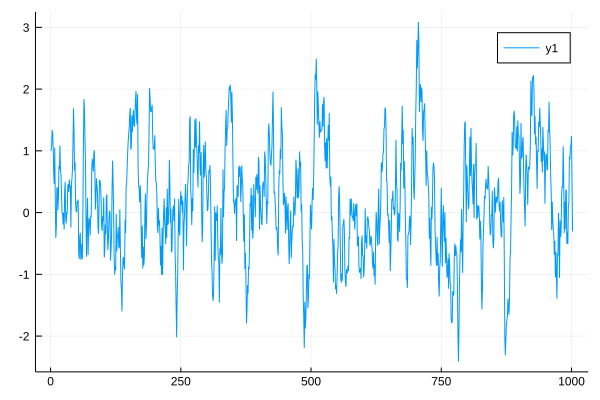

In [35]:
using DifferentialEquations
using Plots

μ = 0.0
σ = sqrt(2)
Θ = 1.0
W = OrnsteinUhlenbeckProcess(Θ,μ,σ,0.0,1.0)
prob = NoiseProblem(W,(0.0,100.0))
sol = solve(prob;dt=0.1)
plot(sol.u)

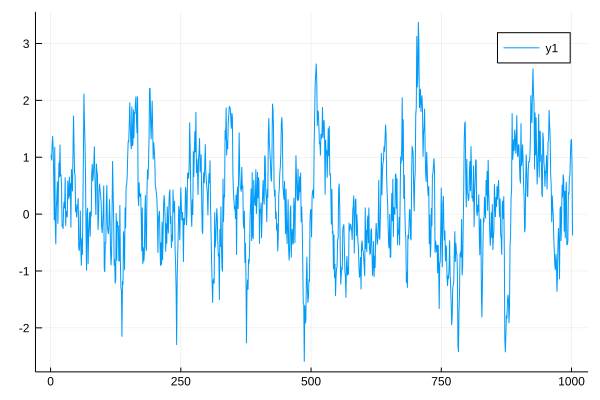

In [36]:
using Distributions, Random
ou_data = sol.u
noise = rand(Normal(0,0.2), length(ou_data))
plot(ou_data.+noise)

In [37]:
using Turing
using Distributions
using LinearAlgebra

# Ornstein-Uhlenbeck process with added Gaussian noise
@model oupn(rn,T,delta_t,::Type{R}=Vector{Float64}) where {R} = begin
    ampl ~ Uniform(0.0,5.0)
    tau ~ Uniform(0.0,5.0)
    noise_ampl ~ Uniform(0.0,1)
    
    b = exp(-delta_t/tau)
    r = R(undef, T)
    
    r[1] ~ Normal(0,sqrt(ampl))
    
    for i=2:T
        r[i] ~ Normal(r[i-1]*b,sqrt(ampl*(1-b^2)))
    end
    rn ~ MvNormal(r,sqrt(ampl))
end

(::DynamicPPL.ModelGen{(:rn, :T, :delta_t, :R),var"###oupn#1533",NamedTuple{(:R,),Tuple{Type{Array{Float64,1}}}}}) (generic function with 1 method)

In [38]:
using StatsPlots

chn = sample(oupn(ou_data.+noise,length(ou_data),0.1), NUTS(0.65), 2000)

# Summarise results (currently requires the master branch from MCMCChains)
describe(chn)



┌ Info: Found initial step size
│   ϵ = 0.05
└ @ Turing.Inference /Users/hstrey/.julia/packages/Turing/vg86q/src/inference/hmc.jl:555
Sampling   0%|                               |  ETA: 9:51:58
  iteration:                     1
  n_steps:                       51
  is_accept:                     true
  acceptance_rate:               0.529413932100406
  log_density:                   -1644.6578289108768
  hamiltonian_energy:            2381.777154448775
  hamiltonian_energy_error:      -128.34462376825104
  max_hamiltonian_energy_error:  1157.561562361926
  tree_depth:                    5
  numerical_error:               true
  step_size:                     0.05
  nom_step_size:                 0.05
4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   0%|                               |  ETA: 5:04:34
  iteration:                     2
  n_steps:                       1
  is_accept:                     true
  acceptance_rate:

4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   1%|▏                              |  ETA: 9:43:36
  iteration:                     11
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.3929994595570464
  log_density:                   -433.55580411954094
  hamiltonian_energy:            933.5497346433848
  hamiltonian_energy_error:      0.8056845729121278
  max_hamiltonian_energy_error:  3.3316484377453435
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.03517907640328703
  nom_step_size:                 0.03517907640328703
4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   1%|▏                              |  ETA: 10:43:26
  iteration:                     12
  n_steps:                       127
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   1%|▍                              |  ETA: 11:02:17
  iteration:                     21
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.937480291316895
  log_density:                   -542.611268850986
  hamiltonian_energy:            1072.8449514960564
  hamiltonian_energy_error:      -0.18601315771070404
  max_hamiltonian_energy_error:  -0.39053538343409855
  tree_depth:                    6
  numerical_error:               false
  step_size:                     0.022455075938224628
  nom_step_size:                 0.022455075938224628
4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   1%|▍                              |  ETA: 10:47:04
  iteration:                     22
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   2%|▌                              |  ETA: 10:07:41
  iteration:                     31
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.9740231955037294
  log_density:                   -549.473244491878
  hamiltonian_energy:            1043.377566860906
  hamiltonian_energy_error:      -0.9229885400388866
  max_hamiltonian_energy_error:  -1.2132993319262368
  tree_depth:                    6
  numerical_error:               false
  step_size:                     0.0325692758576605
  nom_step_size:                 0.0325692758576605
4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   2%|▌                              |  ETA: 9:49:27
  iteration:                     32
  n_steps:                       3
  is_accept:                     true
  acceptance_rate:

4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   2%|▋                              |  ETA: 10:06:48
  iteration:                     41
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.6285421166192695
  log_density:                   -561.8565757999321
  hamiltonian_energy:            1029.9997507987268
  hamiltonian_energy_error:      0.45736978358331726
  max_hamiltonian_energy_error:  1.0541886463065566
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.03808537539453667
  nom_step_size:                 0.03808537539453667
4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   2%|▋                              |  ETA: 9:59:14
  iteration:                     42
  n_steps:                       31
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   3%|▊                              |  ETA: 9:20:42
  iteration:                     51
  n_steps:                       25
  is_accept:                     true
  acceptance_rate:               0.05710031461256635
  log_density:                   -555.0612109051162
  hamiltonian_energy:            1066.2370998329484
  hamiltonian_energy_error:      -0.23072392738617964
  max_hamiltonian_energy_error:  20850.313974879835
  tree_depth:                    4
  numerical_error:               true
  step_size:                     0.06164088486659987
  nom_step_size:                 0.06164088486659987
4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   3%|▊                              |  ETA: 9:32:46
  iteration:                     52
  n_steps:                       127
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   3%|█                              |  ETA: 9:05:28
  iteration:                     61
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8153823180231993
  log_density:                   -541.4581869650559
  hamiltonian_energy:            1016.7060315828496
  hamiltonian_energy_error:      0.3567188293786785
  max_hamiltonian_energy_error:  0.789036628267695
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.03708236282713721
  nom_step_size:                 0.03708236282713721
4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   3%|█                              |  ETA: 9:01:10
  iteration:                     62
  n_steps:                       31
  is_accept:                     true
  acceptance_rate

4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   4%|█▏                             |  ETA: 8:38:09
  iteration:                     71
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.7441557719891465
  log_density:                   -580.2103344783968
  hamiltonian_energy:            1089.09641094977
  hamiltonian_energy_error:      0.3108388674345406
  max_hamiltonian_energy_error:  0.7559283316738856
  tree_depth:                    6
  numerical_error:               false
  step_size:                     0.03500909637633664
  nom_step_size:                 0.03500909637633664
4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   4%|█▏                             |  ETA: 8:34:45
  iteration:                     72
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:

4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   4%|█▎                             |  ETA: 8:20:10
  iteration:                     81
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.11233598849026354
  log_density:                   -646.0557924659233
  hamiltonian_energy:            1164.3848471449687
  hamiltonian_energy_error:      1.363666045924674
  max_hamiltonian_energy_error:  4.225766605147328
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.05398898435263301
  nom_step_size:                 0.05398898435263301
4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   4%|█▎                             |  ETA: 8:21:06
  iteration:                     82
  n_steps:                       63
  is_accept:                     true
  acceptance_rate

4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   5%|█▍                             |  ETA: 8:08:35
  iteration:                     91
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.7747789158906366
  log_density:                   -569.5339509777646
  hamiltonian_energy:            1017.9257483438327
  hamiltonian_energy_error:      1.2935262271328156
  max_hamiltonian_energy_error:  1.2935262271328156
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.05140344545168065
  nom_step_size:                 0.05140344545168065
4m  mass_matrix:                   DiagEuclideanMetric([1.0, 1.0, 1.0, 1.0, 1.0, 1 ...])












Sampling   5%|█▍                             |  ETA: 8:04:04
  iteration:                     92
  n_steps:                       10
  is_accept:                     true
  acceptance_rat

4m  mass_matrix:                   DiagEuclideanMetric([0.002718002719492535, 0.00 ...])












Sampling   5%|█▋                             |  ETA: 8:05:40
  iteration:                     101
  n_steps:                       127
  is_accept:                     true
  acceptance_rate:               0.9929737681107634
  log_density:                   -610.428607533348
  hamiltonian_energy:            1110.3071504123343
  hamiltonian_energy_error:      -0.0016356833766622003
  max_hamiltonian_energy_error:  -0.06463615081815988
  tree_depth:                    7
  numerical_error:               false
  step_size:                     0.059622914656463265
  nom_step_size:                 0.059622914656463265
4m  mass_matrix:                   DiagEuclideanMetric([0.002718002719492535, 0.00 ...])












Sampling   5%|█▋                             |  ETA: 8:00:47
  iteration:                     102
  n_steps:                       1
  is_accept:                     true
  accep

4m  mass_matrix:                   DiagEuclideanMetric([0.002718002719492535, 0.00 ...])












Sampling   6%|█▊                             |  ETA: 7:59:41
  iteration:                     111
  n_steps:                       127
  is_accept:                     true
  acceptance_rate:               0.989857029500978
  log_density:                   -534.2220369814428
  hamiltonian_energy:            1071.2171406850064
  hamiltonian_energy_error:      -0.10294669861900729
  max_hamiltonian_energy_error:  -0.11447237364882312
  tree_depth:                    7
  numerical_error:               false
  step_size:                     0.07216886819267812
  nom_step_size:                 0.07216886819267812
4m  mass_matrix:                   DiagEuclideanMetric([0.002718002719492535, 0.00 ...])












Sampling   6%|█▊                             |  ETA: 7:57:40
  iteration:                     112
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.002718002719492535, 0.00 ...])












Sampling   6%|█▉                             |  ETA: 8:23:02
  iteration:                     121
  n_steps:                       351
  is_accept:                     true
  acceptance_rate:               0.10842456898438514
  log_density:                   -595.9492231571328
  hamiltonian_energy:            1122.6770831414183
  hamiltonian_energy_error:      -0.9863560788505765
  max_hamiltonian_energy_error:  7.0133380021195535
  tree_depth:                    8
  numerical_error:               false
  step_size:                     0.36818865076963025
  nom_step_size:                 0.36818865076963025
4m  mass_matrix:                   DiagEuclideanMetric([0.002718002719492535, 0.00 ...])












Sampling   6%|█▉                             |  ETA: 8:28:05
  iteration:                     122
  n_steps:                       127
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.002718002719492535, 0.00 ...])












Sampling   7%|██                             |  ETA: 8:31:04
  iteration:                     131
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8233974665293667
  log_density:                   -639.0994523903302
  hamiltonian_energy:            1160.002358458485
  hamiltonian_energy_error:      -1.0645164278721495
  max_hamiltonian_energy_error:  -3.2550155716221525
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.3273868226077938
  nom_step_size:                 0.3273868226077938
4m  mass_matrix:                   DiagEuclideanMetric([0.002718002719492535, 0.00 ...])












Sampling   7%|██                             |  ETA: 8:27:58
  iteration:                     132
  n_steps:                       15
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.002718002719492535, 0.00 ...])












Sampling   7%|██▏                            |  ETA: 8:19:15
  iteration:                     141
  n_steps:                       15
  is_accept:                     true
  acceptance_rate:               0.07058123127872104
  log_density:                   -554.8200919214028
  hamiltonian_energy:            1092.5510157574074
  hamiltonian_energy_error:      -0.8910929258795477
  max_hamiltonian_energy_error:  9.673736153824848
  tree_depth:                    4
  numerical_error:               false
  step_size:                     0.42476062967535644
  nom_step_size:                 0.42476062967535644
4m  mass_matrix:                   DiagEuclideanMetric([0.002718002719492535, 0.00 ...])












Sampling   7%|██▎                            |  ETA: 8:19:26
  iteration:                     142
  n_steps:                       63
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.0019630556967540924, 0.0 ...])












Sampling   8%|██▍                            |  ETA: 9:00:54
  iteration:                     151
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.9149021177849427
  log_density:                   -536.7334593306896
  hamiltonian_energy:            1061.0676727185974
  hamiltonian_energy_error:      -0.1004457870162696
  max_hamiltonian_energy_error:  0.2439462004847428
  tree_depth:                    6
  numerical_error:               false
  step_size:                     0.10946873696954927
  nom_step_size:                 0.10946873696954927
4m  mass_matrix:                   DiagEuclideanMetric([0.0019630556967540924, 0.0 ...])












Sampling   8%|██▍                            |  ETA: 8:57:08
  iteration:                     152
  n_steps:                       1
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.0019630556967540924, 0.0 ...])












Sampling   8%|██▌                            |  ETA: 8:51:14
  iteration:                     161
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.18774231181163312
  log_density:                   -481.8672842841537
  hamiltonian_energy:            990.1859449103971
  hamiltonian_energy_error:      -0.5355925612656165
  max_hamiltonian_energy_error:  4.624840232046381
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.27422904618673954
  nom_step_size:                 0.27422904618673954
4m  mass_matrix:                   DiagEuclideanMetric([0.0019630556967540924, 0.0 ...])












Sampling   8%|██▌                            |  ETA: 8:54:31
  iteration:                     162
  n_steps:                       127
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.0019630556967540924, 0.0 ...])












Sampling   9%|██▋                            |  ETA: 8:56:51
  iteration:                     171
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               1.0
  log_density:                   -549.5815616770705
  hamiltonian_energy:            1084.8859481015481
  hamiltonian_energy_error:      -2.434068140706586
  max_hamiltonian_energy_error:  -2.7569802028517643
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.21812709178279732
  nom_step_size:                 0.21812709178279732
4m  mass_matrix:                   DiagEuclideanMetric([0.0019630556967540924, 0.0 ...])












Sampling   9%|██▋                            |  ETA: 8:55:01
  iteration:                     172
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:          

4m  mass_matrix:                   DiagEuclideanMetric([0.0019630556967540924, 0.0 ...])












Sampling   9%|██▊                            |  ETA: 9:01:23
  iteration:                     181
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.9940563758373302
  log_density:                   -516.2016146303414
  hamiltonian_energy:            1037.1305217109123
  hamiltonian_energy_error:      -0.6718737709973084
  max_hamiltonian_energy_error:  -0.6718737709973084
  tree_depth:                    6
  numerical_error:               false
  step_size:                     0.13398895061642055
  nom_step_size:                 0.13398895061642055
4m  mass_matrix:                   DiagEuclideanMetric([0.0019630556967540924, 0.0 ...])












Sampling   9%|██▉                            |  ETA: 9:01:06
  iteration:                     182
  n_steps:                       63
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.0019630556967540924, 0.0 ...])












Sampling  10%|███                            |  ETA: 9:02:05
  iteration:                     191
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8757327992839247
  log_density:                   -468.9246659386253
  hamiltonian_energy:            949.7021813592273
  hamiltonian_energy_error:      -1.804600260205234
  max_hamiltonian_energy_error:  -1.8094918365691228
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.23912828821016122
  nom_step_size:                 0.23912828821016122
4m  mass_matrix:                   DiagEuclideanMetric([0.0019630556967540924, 0.0 ...])












Sampling  10%|███                            |  ETA: 9:03:54
  iteration:                     192
  n_steps:                       111
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.0019630556967540924, 0.0 ...])












Sampling  10%|███▏                           |  ETA: 8:55:37
  iteration:                     201
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.9575747551563127
  log_density:                   -541.3819091094211
  hamiltonian_energy:            1032.6454473505503
  hamiltonian_energy_error:      0.07310437675869252
  max_hamiltonian_energy_error:  -0.2949786813671835
  tree_depth:                    6
  numerical_error:               false
  step_size:                     0.10450394507398002
  nom_step_size:                 0.10450394507398002
4m  mass_matrix:                   DiagEuclideanMetric([0.0019630556967540924, 0.0 ...])












Sampling  10%|███▏                           |  ETA: 8:53:59
  iteration:                     202
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.0019630556967540924, 0.0 ...])












Sampling  11%|███▎                           |  ETA: 8:43:08
  iteration:                     211
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.46538533833001056
  log_density:                   -614.3870641895314
  hamiltonian_energy:            1096.025107738516
  hamiltonian_energy_error:      0.9119715036886191
  max_hamiltonian_energy_error:  2.2481214736124002
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.2933753822778065
  nom_step_size:                 0.2933753822778065
4m  mass_matrix:                   DiagEuclideanMetric([0.0019630556967540924, 0.0 ...])












Sampling  11%|███▎                           |  ETA: 8:41:38
  iteration:                     212
  n_steps:                       31
  is_accept:                     true
  acceptance_rat

4m  mass_matrix:                   DiagEuclideanMetric([0.0019630556967540924, 0.0 ...])












Sampling  11%|███▍                           |  ETA: 8:34:44
  iteration:                     221
  n_steps:                       47
  is_accept:                     true
  acceptance_rate:               0.08454860883404046
  log_density:                   -589.3059952621949
  hamiltonian_energy:            1078.6138704401847
  hamiltonian_energy_error:      -0.03134637592506806
  max_hamiltonian_energy_error:  8.476413526809438
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.4911777087657332
  nom_step_size:                 0.4911777087657332
4m  mass_matrix:                   DiagEuclideanMetric([0.0019630556967540924, 0.0 ...])












Sampling  11%|███▌                           |  ETA: 8:34:32
  iteration:                     222
  n_steps:                       63
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.0019630556967540924, 0.0 ...])












Sampling  12%|███▋                           |  ETA: 8:26:20
  iteration:                     231
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.9457955273709512
  log_density:                   -561.4475654654696
  hamiltonian_energy:            1058.2473024850842
  hamiltonian_energy_error:      -0.08901594838721394
  max_hamiltonian_energy_error:  -0.3626144958977875
  tree_depth:                    6
  numerical_error:               false
  step_size:                     0.1307489311128563
  nom_step_size:                 0.1307489311128563
4m  mass_matrix:                   DiagEuclideanMetric([0.0019630556967540924, 0.0 ...])












Sampling  12%|███▋                           |  ETA: 8:25:00
  iteration:                     232
  n_steps:                       31
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.0019630556967540924, 0.0 ...])












Sampling  12%|███▊                           |  ETA: 8:21:10
  iteration:                     241
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.6510861697844488
  log_density:                   -594.603601543671
  hamiltonian_energy:            1096.752690397339
  hamiltonian_energy_error:      -1.8966425170926868
  max_hamiltonian_energy_error:  2.383135775666915
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.3273936243850728
  nom_step_size:                 0.3273936243850728
4m  mass_matrix:                   DiagEuclideanMetric([0.0019630556967540924, 0.0 ...])












Sampling  12%|███▊                           |  ETA: 8:21:00
  iteration:                     242
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:

4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  13%|███▉                           |  ETA: 8:14:07
  iteration:                     251
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.4603180075564892
  log_density:                   -597.3008645945397
  hamiltonian_energy:            1129.2152329523683
  hamiltonian_energy_error:      0.19578529851696658
  max_hamiltonian_energy_error:  2.063351834018931
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.21731779264530204
  nom_step_size:                 0.21731779264530204
4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  13%|███▉                           |  ETA: 8:11:56
  iteration:                     252
  n_steps:                       1
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  13%|████                           |  ETA: 8:09:29
  iteration:                     261
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9534901932419115
  log_density:                   -526.357080452583
  hamiltonian_energy:            1015.9026595429729
  hamiltonian_energy_error:      -0.3211953631326878
  max_hamiltonian_energy_error:  -0.5206581118661688
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.1965068580078398
  nom_step_size:                 0.1965068580078398
4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  13%|████                           |  ETA: 8:22:46
  iteration:                     262
  n_steps:                       495
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  14%|████▎                          |  ETA: 8:17:51
  iteration:                     271
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.0875973531283266
  log_density:                   -587.7297362349631
  hamiltonian_energy:            1119.4035184149848
  hamiltonian_energy_error:      1.377789700615267
  max_hamiltonian_energy_error:  4.028060547743507
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.2953631630779182
  nom_step_size:                 0.2953631630779182
4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  14%|████▎                          |  ETA: 8:19:32
  iteration:                     272
  n_steps:                       127
  is_accept:                     true
  acceptance_rate

4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  14%|████▍                          |  ETA: 8:23:26
  iteration:                     281
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.9836322251040829
  log_density:                   -564.6167243918135
  hamiltonian_energy:            1074.361855340054
  hamiltonian_energy_error:      -0.05205642984833503
  max_hamiltonian_energy_error:  -0.16921620847597296
  tree_depth:                    6
  numerical_error:               false
  step_size:                     0.0870142665030019
  nom_step_size:                 0.0870142665030019
4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  14%|████▍                          |  ETA: 8:22:15
  iteration:                     282
  n_steps:                       31
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  15%|████▌                          |  ETA: 8:18:11
  iteration:                     291
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.2215518897845536
  log_density:                   -533.0760579979277
  hamiltonian_energy:            1023.8407305643086
  hamiltonian_energy_error:      2.1136867708207774
  max_hamiltonian_energy_error:  3.815655595402177
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.24240764195168266
  nom_step_size:                 0.24240764195168266
4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  15%|████▌                          |  ETA: 8:17:56
  iteration:                     292
  n_steps:                       63
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  15%|████▋                          |  ETA: 8:09:18
  iteration:                     301
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8506594743973381
  log_density:                   -541.1614830031709
  hamiltonian_energy:            1010.7392917802745
  hamiltonian_energy_error:      -0.42605219607685285
  max_hamiltonian_energy_error:  -1.6659334760511229
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.2688949854424607
  nom_step_size:                 0.2688949854424607
4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  15%|████▋                          |  ETA: 8:07:48
  iteration:                     302
  n_steps:                       15
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  16%|████▉                          |  ETA: 8:01:41
  iteration:                     311
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.87004776580442
  log_density:                   -543.4988750001934
  hamiltonian_energy:            1083.2894304754327
  hamiltonian_energy_error:      -0.40230138239735425
  max_hamiltonian_energy_error:  -0.4674274660078481
  tree_depth:                    6
  numerical_error:               false
  step_size:                     0.1496584715596973
  nom_step_size:                 0.1496584715596973
4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  16%|████▉                          |  ETA: 8:00:39
  iteration:                     312
  n_steps:                       31
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  16%|█████                          |  ETA: 7:53:13
  iteration:                     321
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.8361231661597363
  log_density:                   -544.8505791341906
  hamiltonian_energy:            1078.6332531824532
  hamiltonian_energy_error:      -0.14253770301820623
  max_hamiltonian_energy_error:  0.5834272060517378
  tree_depth:                    6
  numerical_error:               false
  step_size:                     0.1424909889997605
  nom_step_size:                 0.1424909889997605
4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  16%|█████                          |  ETA: 7:52:14
  iteration:                     322
  n_steps:                       31
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  17%|█████▏                         |  ETA: 8:00:17
  iteration:                     331
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.7409364471872015
  log_density:                   -558.3340522679857
  hamiltonian_energy:            1043.6121009657904
  hamiltonian_energy_error:      0.31197172017982666
  max_hamiltonian_energy_error:  1.1015864170033183
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.19681566873066336
  nom_step_size:                 0.19681566873066336
4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  17%|█████▏                         |  ETA: 7:59:17
  iteration:                     332
  n_steps:                       31
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  17%|█████▎                         |  ETA: 7:52:49
  iteration:                     341
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.9916762081706226
  log_density:                   -613.9099633945351
  hamiltonian_energy:            1129.2873815102416
  hamiltonian_energy_error:      -0.32464645466757247
  max_hamiltonian_energy_error:  -0.6958869986651735
  tree_depth:                    6
  numerical_error:               false
  step_size:                     0.12420597979182728
  nom_step_size:                 0.12420597979182728
4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  17%|█████▎                         |  ETA: 7:51:52
  iteration:                     342
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  18%|█████▌                         |  ETA: 7:45:19
  iteration:                     351
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.7332284351281231
  log_density:                   -680.686503189829
  hamiltonian_energy:            1197.6265581618263
  hamiltonian_energy_error:      0.48118001517832454
  max_hamiltonian_energy_error:  0.8903875101682388
  tree_depth:                    6
  numerical_error:               false
  step_size:                     0.15151728475610127
  nom_step_size:                 0.15151728475610127
4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  18%|█████▌                         |  ETA: 7:46:31
  iteration:                     352
  n_steps:                       127
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  18%|█████▋                         |  ETA: 7:40:09
  iteration:                     361
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.732263805573907
  log_density:                   -610.3116391169775
  hamiltonian_energy:            1118.10845409044
  hamiltonian_energy_error:      0.12319980134657271
  max_hamiltonian_energy_error:  0.877639615111093
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.2210663534709305
  nom_step_size:                 0.2210663534709305
4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  18%|█████▋                         |  ETA: 7:39:17
  iteration:                     362
  n_steps:                       31
  is_accept:                     true
  acceptance_rate: 

4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  19%|█████▊                         |  ETA: 7:32:50
  iteration:                     371
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9797040104062447
  log_density:                   -677.5812178948904
  hamiltonian_energy:            1195.6560528957252
  hamiltonian_energy_error:      -0.1709499542798767
  max_hamiltonian_energy_error:  -1.1409131937953134
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.2252889041891204
  nom_step_size:                 0.2252889041891204
4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  19%|█████▊                         |  ETA: 7:31:40
  iteration:                     372
  n_steps:                       15
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  19%|█████▉                         |  ETA: 7:29:39
  iteration:                     381
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.8232389639777825
  log_density:                   -485.0424135177168
  hamiltonian_energy:            1001.4114829018173
  hamiltonian_energy_error:      -0.26533200818118985
  max_hamiltonian_energy_error:  0.48132933774218145
  tree_depth:                    6
  numerical_error:               false
  step_size:                     0.12433119641300895
  nom_step_size:                 0.12433119641300895
4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  19%|█████▉                         |  ETA: 7:29:27
  iteration:                     382
  n_steps:                       63
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  20%|██████                         |  ETA: 7:23:24
  iteration:                     391
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.7277503341909808
  log_density:                   -461.02746298424404
  hamiltonian_energy:            972.5787297606118
  hamiltonian_energy_error:      -0.5234776887109547
  max_hamiltonian_energy_error:  0.9706030697097958
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.17071820516259764
  nom_step_size:                 0.17071820516259764
4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  20%|██████▏                        |  ETA: 7:22:36
  iteration:                     392
  n_steps:                       31
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  20%|██████▎                        |  ETA: 7:17:22
  iteration:                     401
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8483799268241193
  log_density:                   -573.1612353773222
  hamiltonian_energy:            1088.6285364880478
  hamiltonian_energy_error:      -0.8334930016358157
  max_hamiltonian_energy_error:  -1.2271270735784583
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.1954555562599501
  nom_step_size:                 0.1954555562599501
4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  20%|██████▎                        |  ETA: 7:16:36
  iteration:                     402
  n_steps:                       31
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  21%|██████▍                        |  ETA: 7:11:02
  iteration:                     411
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9993504402034675
  log_density:                   -538.4765636029815
  hamiltonian_energy:            1035.4883016138588
  hamiltonian_energy_error:      -0.8007111526021617
  max_hamiltonian_energy_error:  -1.2061819584296245
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.19168644411248822
  nom_step_size:                 0.19168644411248822
4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  21%|██████▍                        |  ETA: 7:10:18
  iteration:                     412
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  21%|██████▌                        |  ETA: 7:10:34
  iteration:                     421
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.7891530379179339
  log_density:                   -538.4903002459478
  hamiltonian_energy:            1026.0141745727933
  hamiltonian_energy_error:      0.14362878533393086
  max_hamiltonian_energy_error:  0.7384371689588534
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.17679870125666705
  nom_step_size:                 0.17679870125666705
4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  21%|██████▌                        |  ETA: 7:09:50
  iteration:                     422
  n_steps:                       31
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  22%|██████▋                        |  ETA: 7:05:00
  iteration:                     431
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8274698126791311
  log_density:                   -558.1390012500991
  hamiltonian_energy:            1026.2888528676722
  hamiltonian_energy_error:      0.033211266929811245
  max_hamiltonian_energy_error:  1.33622248658844
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.2031707890024264
  nom_step_size:                 0.2031707890024264
4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  22%|██████▊                        |  ETA: 7:04:17
  iteration:                     432
  n_steps:                       31
  is_accept:                     true
  acceptance_rat

4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  22%|██████▉                        |  ETA: 6:58:48
  iteration:                     441
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8785173075986557
  log_density:                   -562.9237009445898
  hamiltonian_energy:            1070.8168262003414
  hamiltonian_energy_error:      -0.6458702983395597
  max_hamiltonian_energy_error:  -0.9703839109754426
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.22565203009066429
  nom_step_size:                 0.22565203009066429
4m  mass_matrix:                   DiagEuclideanMetric([0.0026993998776399138, 0.0 ...])












Sampling  22%|██████▉                        |  ETA: 6:58:07
  iteration:                     442
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  23%|███████                        |  ETA: 6:53:03
  iteration:                     451
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.67218097024269
  log_density:                   -542.2691004564616
  hamiltonian_energy:            1088.1373193588706
  hamiltonian_energy_error:      -2.5002860931931536
  max_hamiltonian_energy_error:  -3.0863602352278576
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.2455464495097659
  nom_step_size:                 0.2455464495097659
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  23%|███████                        |  ETA: 6:51:54
  iteration:                     452
  n_steps:                       1
  is_accept:                     true
  acceptance_rate

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  23%|███████▏                       |  ETA: 6:52:49
  iteration:                     461
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8904766135242942
  log_density:                   -545.2484733889247
  hamiltonian_energy:            1093.9304735202381
  hamiltonian_energy_error:      -0.6592918076762544
  max_hamiltonian_energy_error:  -0.6811965182084805
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.16276583361840244
  nom_step_size:                 0.16276583361840244
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  23%|███████▏                       |  ETA: 6:53:40
  iteration:                     462
  n_steps:                       127
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  24%|███████▎                       |  ETA: 7:12:59
  iteration:                     471
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.5621206415855156
  log_density:                   -594.2936606903886
  hamiltonian_energy:            1082.31088754533
  hamiltonian_energy_error:      0.8691035246113188
  max_hamiltonian_energy_error:  2.0647404246763017
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.2239361275588962
  nom_step_size:                 0.2239361275588962
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  24%|███████▍                       |  ETA: 7:12:16
  iteration:                     472
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  24%|███████▌                       |  ETA: 7:22:48
  iteration:                     481
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.9140701466942
  log_density:                   -588.9888478615211
  hamiltonian_energy:            1082.623215086868
  hamiltonian_energy_error:      0.07574237626613467
  max_hamiltonian_energy_error:  0.33492658728596325
  tree_depth:                    6
  numerical_error:               false
  step_size:                     0.11048804069923474
  nom_step_size:                 0.11048804069923474
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  24%|███████▌                       |  ETA: 7:22:04
  iteration:                     482
  n_steps:                       31
  is_accept:                     true
  acceptance_rat

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  25%|███████▋                       |  ETA: 7:19:14
  iteration:                     491
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9998742958092802
  log_density:                   -510.1146612143903
  hamiltonian_energy:            1000.6261315987199
  hamiltonian_energy_error:      -0.5321478568779412
  max_hamiltonian_energy_error:  -1.3133582957174212
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.17929544879430148
  nom_step_size:                 0.17929544879430148
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  25%|███████▋                       |  ETA: 7:19:12
  iteration:                     492
  n_steps:                       79
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  25%|███████▊                       |  ETA: 7:15:40
  iteration:                     501
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.47299304014900695
  log_density:                   -484.63642244734893
  hamiltonian_energy:            1010.6039347885132
  hamiltonian_energy_error:      -0.17827885757139939
  max_hamiltonian_energy_error:  2.231043473003524
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18255769637760583
  nom_step_size:                 0.18255769637760583
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  25%|███████▊                       |  ETA: 7:15:24
  iteration:                     502
  n_steps:                       63
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  26%|███████▉                       |  ETA: 7:29:43
  iteration:                     511
  n_steps:                       47
  is_accept:                     true
  acceptance_rate:               0.48948048326531274
  log_density:                   -584.6251183592698
  hamiltonian_energy:            1095.799797811578
  hamiltonian_energy_error:      -0.6070660700456756
  max_hamiltonian_energy_error:  3.2458290821614355
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.35778153861849155
  nom_step_size:                 0.35778153861849155
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  26%|███████▉                       |  ETA: 7:28:59
  iteration:                     512
  n_steps:                       31
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  26%|████████▏                      |  ETA: 7:23:12
  iteration:                     521
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.9739461865941718
  log_density:                   -539.1247020079277
  hamiltonian_energy:            1022.000500751567
  hamiltonian_energy_error:      -0.17373183120184876
  max_hamiltonian_energy_error:  -0.44067614671848787
  tree_depth:                    6
  numerical_error:               false
  step_size:                     0.13696808123333643
  nom_step_size:                 0.13696808123333643
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  26%|████████▏                      |  ETA: 7:22:29
  iteration:                     522
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  27%|████████▎                      |  ETA: 7:19:25
  iteration:                     531
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.9358638500325749
  log_density:                   -565.7668893045794
  hamiltonian_energy:            1052.8763673280514
  hamiltonian_energy_error:      0.02100185031622459
  max_hamiltonian_energy_error:  -1.0677579166583655
  tree_depth:                    6
  numerical_error:               false
  step_size:                     0.14585344875130407
  nom_step_size:                 0.14585344875130407
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  27%|████████▎                      |  ETA: 7:18:45
  iteration:                     532
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  27%|████████▍                      |  ETA: 7:14:41
  iteration:                     541
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9988386302884064
  log_density:                   -585.3731582613608
  hamiltonian_energy:            1062.1740120968298
  hamiltonian_energy_error:      -0.5290879836736622
  max_hamiltonian_energy_error:  -1.8598510305785112
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.19863294119462802
  nom_step_size:                 0.19863294119462802
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  27%|████████▍                      |  ETA: 7:13:47
  iteration:                     542
  n_steps:                       15
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  28%|████████▌                      |  ETA: 7:08:28
  iteration:                     551
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.5908510044948762
  log_density:                   -563.494425905946
  hamiltonian_energy:            1070.3249459037884
  hamiltonian_energy_error:      0.5619172797969441
  max_hamiltonian_energy_error:  1.511566556872367
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.21155310824671014
  nom_step_size:                 0.21155310824671014
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  28%|████████▌                      |  ETA: 7:07:47
  iteration:                     552
  n_steps:                       31
  is_accept:                     true
  acceptance_rat

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  28%|████████▊                      |  ETA: 7:02:27
  iteration:                     561
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9553778588748263
  log_density:                   -590.5969736980898
  hamiltonian_energy:            1124.3857799410575
  hamiltonian_energy_error:      -0.7829859660325837
  max_hamiltonian_energy_error:  -1.0689174809283486
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.1710555991050274
  nom_step_size:                 0.1710555991050274
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  28%|████████▊                      |  ETA: 7:01:48
  iteration:                     562
  n_steps:                       31
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  29%|████████▉                      |  ETA: 6:57:54
  iteration:                     571
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.9720428338318368
  log_density:                   -500.3166414138456
  hamiltonian_energy:            1011.811218336254
  hamiltonian_energy_error:      -0.3448720643740444
  max_hamiltonian_energy_error:  -0.5055252490468547
  tree_depth:                    6
  numerical_error:               false
  step_size:                     0.1386999161477216
  nom_step_size:                 0.1386999161477216
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  29%|████████▉                      |  ETA: 6:57:15
  iteration:                     572
  n_steps:                       31
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  29%|█████████                      |  ETA: 6:52:36
  iteration:                     581
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.7257396517955939
  log_density:                   -575.1213506222086
  hamiltonian_energy:            1058.5054814563305
  hamiltonian_energy_error:      0.2615598337536085
  max_hamiltonian_energy_error:  0.8223796577149187
  tree_depth:                    6
  numerical_error:               false
  step_size:                     0.16401844931523943
  nom_step_size:                 0.16401844931523943
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  29%|█████████                      |  ETA: 6:51:58
  iteration:                     582
  n_steps:                       31
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  30%|█████████▏                     |  ETA: 6:47:09
  iteration:                     591
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.7784006941377483
  log_density:                   -528.6079562271127
  hamiltonian_energy:            1063.8663179071418
  hamiltonian_energy_error:      -0.6181742577880414
  max_hamiltonian_energy_error:  0.8678708354152604
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.17408276036594794
  nom_step_size:                 0.17408276036594794
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  30%|█████████▏                     |  ETA: 6:46:32
  iteration:                     592
  n_steps:                       31
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  30%|█████████▍                     |  ETA: 6:42:11
  iteration:                     601
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.7630001600304028
  log_density:                   -582.3689413326058
  hamiltonian_energy:            1102.1279882494891
  hamiltonian_energy_error:      0.03557457341935333
  max_hamiltonian_energy_error:  1.113508402778507
  tree_depth:                    6
  numerical_error:               false
  step_size:                     0.15355087954658322
  nom_step_size:                 0.15355087954658322
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  30%|█████████▍                     |  ETA: 6:41:35
  iteration:                     602
  n_steps:                       31
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  31%|█████████▌                     |  ETA: 6:36:19
  iteration:                     611
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.7957701538883727
  log_density:                   -583.8477390773307
  hamiltonian_energy:            1098.0504263183245
  hamiltonian_energy_error:      -0.12603508938536834
  max_hamiltonian_energy_error:  0.7750798682798177
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18432019877849048
  nom_step_size:                 0.18432019877849048
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  31%|█████████▌                     |  ETA: 6:36:09
  iteration:                     612
  n_steps:                       63
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  31%|█████████▋                     |  ETA: 6:32:00
  iteration:                     621
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.1762858887872121
  log_density:                   -570.0422428796923
  hamiltonian_energy:            1101.3362047161872
  hamiltonian_energy_error:      -0.6412843529265047
  max_hamiltonian_energy_error:  6.245600693790266
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.30555373987357115
  nom_step_size:                 0.30555373987357115
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  31%|█████████▋                     |  ETA: 6:31:47
  iteration:                     622
  n_steps:                       63
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  32%|█████████▊                     |  ETA: 6:33:01
  iteration:                     631
  n_steps:                       95
  is_accept:                     true
  acceptance_rate:               0.5049179551751566
  log_density:                   -592.2265966764334
  hamiltonian_energy:            1080.7140190879009
  hamiltonian_energy_error:      0.7318271406838903
  max_hamiltonian_energy_error:  3.2998338911233986
  tree_depth:                    6
  numerical_error:               false
  step_size:                     0.35033982460019675
  nom_step_size:                 0.35033982460019675
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  32%|█████████▊                     |  ETA: 6:32:26
  iteration:                     632
  n_steps:                       31
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  32%|█████████▉                     |  ETA: 6:27:49
  iteration:                     641
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.9128865877161711
  log_density:                   -533.8760621538609
  hamiltonian_energy:            1013.1854292087631
  hamiltonian_energy_error:      0.0791922350221057
  max_hamiltonian_energy_error:  0.4787845609903343
  tree_depth:                    6
  numerical_error:               false
  step_size:                     0.13910180834864583
  nom_step_size:                 0.13910180834864583
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  32%|██████████                     |  ETA: 6:27:15
  iteration:                     642
  n_steps:                       31
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  33%|██████████▏                    |  ETA: 6:22:23
  iteration:                     651
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.6838301593550531
  log_density:                   -584.765662794018
  hamiltonian_energy:            1120.3806753416732
  hamiltonian_energy_error:      -0.9872530220329736
  max_hamiltonian_energy_error:  1.5512958190765858
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.2587488606477047
  nom_step_size:                 0.2587488606477047
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  33%|██████████▏                    |  ETA: 6:21:50
  iteration:                     652
  n_steps:                       31
  is_accept:                     true
  acceptance_rat

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  33%|██████████▎                    |  ETA: 6:17:08
  iteration:                     661
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8511407118242865
  log_density:                   -587.004931247335
  hamiltonian_energy:            1099.5729305610894
  hamiltonian_energy_error:      -0.2349394177456361
  max_hamiltonian_energy_error:  0.6699601781158435
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.21494291468486368
  nom_step_size:                 0.21494291468486368
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  33%|██████████▎                    |  ETA: 6:16:35
  iteration:                     662
  n_steps:                       31
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  34%|██████████▍                    |  ETA: 6:13:11
  iteration:                     671
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9440348810419795
  log_density:                   -590.0092521244457
  hamiltonian_energy:            1114.6025031367226
  hamiltonian_energy_error:      -0.9665979435224017
  max_hamiltonian_energy_error:  -1.7256098660661792
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.20288193760836515
  nom_step_size:                 0.20288193760836515
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  34%|██████████▍                    |  ETA: 6:12:39
  iteration:                     672
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  34%|██████████▌                    |  ETA: 6:08:18
  iteration:                     681
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.05896710530114123
  log_density:                   -562.0046431584354
  hamiltonian_energy:            1066.2474542211107
  hamiltonian_energy_error:      3.1769131077435304
  max_hamiltonian_energy_error:  5.031254069286206
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.25289763682959515
  nom_step_size:                 0.25289763682959515
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  34%|██████████▋                    |  ETA: 6:08:06
  iteration:                     682
  n_steps:                       63
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  35%|██████████▊                    |  ETA: 6:03:57
  iteration:                     691
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8399338375338007
  log_density:                   -544.4930439008293
  hamiltonian_energy:            1043.910528805078
  hamiltonian_energy_error:      -0.023455376249557958
  max_hamiltonian_energy_error:  0.9098023389142327
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.23688860328827685
  nom_step_size:                 0.23688860328827685
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  35%|██████████▊                    |  ETA: 6:03:26
  iteration:                     692
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  35%|██████████▉                    |  ETA: 6:01:27
  iteration:                     701
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8066014434540691
  log_density:                   -563.9920215700612
  hamiltonian_energy:            1064.751944832402
  hamiltonian_energy_error:      0.32037248518736305
  max_hamiltonian_energy_error:  0.5923152306272641
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.19888124483441458
  nom_step_size:                 0.19888124483441458
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  35%|██████████▉                    |  ETA: 6:00:56
  iteration:                     702
  n_steps:                       31
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  36%|███████████                    |  ETA: 5:58:00
  iteration:                     711
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.908708906266506
  log_density:                   -561.7604799870521
  hamiltonian_energy:            1036.8736976219195
  hamiltonian_energy_error:      0.12026387811079076
  max_hamiltonian_energy_error:  -0.7630690922974281
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.20609353324545687
  nom_step_size:                 0.20609353324545687
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  36%|███████████                    |  ETA: 5:57:29
  iteration:                     712
  n_steps:                       31
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  36%|███████████▏                   |  ETA: 5:52:49
  iteration:                     721
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.055474200264324466
  log_density:                   -564.0218808125638
  hamiltonian_energy:            1057.0243248953548
  hamiltonian_energy_error:      3.2530044226386963
  max_hamiltonian_energy_error:  5.783679116865187
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.24768695207673863
  nom_step_size:                 0.24768695207673863
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  36%|███████████▎                   |  ETA: 5:52:36
  iteration:                     722
  n_steps:                       63
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  37%|███████████▍                   |  ETA: 5:48:56
  iteration:                     731
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.7685981864351679
  log_density:                   -538.6748027543694
  hamiltonian_energy:            1038.6022474118515
  hamiltonian_energy_error:      0.011118438553239685
  max_hamiltonian_energy_error:  0.9402163266311163
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.19701848062754923
  nom_step_size:                 0.19701848062754923
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  37%|███████████▍                   |  ETA: 5:48:27
  iteration:                     732
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  37%|███████████▌                   |  ETA: 5:44:04
  iteration:                     741
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.3338944429880414
  log_density:                   -504.80050486074356
  hamiltonian_energy:            977.709293070667
  hamiltonian_energy_error:      1.16653786807683
  max_hamiltonian_energy_error:  2.858637428120687
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.22663886492906515
  nom_step_size:                 0.22663886492906515
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  37%|███████████▌                   |  ETA: 5:43:51
  iteration:                     742
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  38%|███████████▋                   |  ETA: 5:41:03
  iteration:                     751
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.947261728120278
  log_density:                   -541.8163023198555
  hamiltonian_energy:            1012.4913697316739
  hamiltonian_energy_error:      0.058523678368260335
  max_hamiltonian_energy_error:  -1.3241185646352278
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.21933673765366674
  nom_step_size:                 0.21933673765366674
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  38%|███████████▋                   |  ETA: 5:40:34
  iteration:                     752
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  38%|███████████▊                   |  ETA: 5:36:34
  iteration:                     761
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9006906462807744
  log_density:                   -533.0194401497097
  hamiltonian_energy:            1032.3919557926015
  hamiltonian_energy_error:      -0.1769034550654851
  max_hamiltonian_energy_error:  -0.7582294619639924
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18682562363637062
  nom_step_size:                 0.18682562363637062
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  38%|███████████▊                   |  ETA: 5:36:05
  iteration:                     762
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  39%|████████████                   |  ETA: 5:32:52
  iteration:                     771
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9870145076356817
  log_density:                   -604.3018415529259
  hamiltonian_energy:            1140.0040856484427
  hamiltonian_energy_error:      -1.0150609284837628
  max_hamiltonian_energy_error:  -1.2162116220517873
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.21781401373881148
  nom_step_size:                 0.21781401373881148
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  39%|████████████                   |  ETA: 5:32:24
  iteration:                     772
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  39%|████████████▏                  |  ETA: 5:33:21
  iteration:                     781
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.796448715379553
  log_density:                   -558.3983459889612
  hamiltonian_energy:            1053.6049865596822
  hamiltonian_energy_error:      -0.3714102076658037
  max_hamiltonian_energy_error:  0.8783109093517396
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.19287572298310043
  nom_step_size:                 0.19287572298310043
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  39%|████████████▏                  |  ETA: 5:32:53
  iteration:                     782
  n_steps:                       31
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  40%|████████████▎                  |  ETA: 5:29:25
  iteration:                     791
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.5799857222710044
  log_density:                   -530.2293976150748
  hamiltonian_energy:            1019.6730710392364
  hamiltonian_energy_error:      0.2421946525162184
  max_hamiltonian_energy_error:  1.2166845317329944
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.17908768498458516
  nom_step_size:                 0.17908768498458516
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  40%|████████████▎                  |  ETA: 5:29:39
  iteration:                     792
  n_steps:                       127
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  40%|████████████▍                  |  ETA: 5:25:45
  iteration:                     801
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.6752617793629235
  log_density:                   -528.7822506656742
  hamiltonian_energy:            1008.3015944380365
  hamiltonian_energy_error:      0.02972454395501245
  max_hamiltonian_energy_error:  1.5307828453047705
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.24769477757140193
  nom_step_size:                 0.24769477757140193
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  40%|████████████▍                  |  ETA: 5:25:18
  iteration:                     802
  n_steps:                       31
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  41%|████████████▋                  |  ETA: 5:21:41
  iteration:                     811
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.18286131821797225
  log_density:                   -511.9546134483279
  hamiltonian_energy:            1000.7630029836168
  hamiltonian_energy_error:      0.8668537878075995
  max_hamiltonian_energy_error:  3.4061307661892215
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.2291360877384346
  nom_step_size:                 0.2291360877384346
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  41%|████████████▋                  |  ETA: 5:21:28
  iteration:                     812
  n_steps:                       63
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  41%|████████████▊                  |  ETA: 5:17:54
  iteration:                     821
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8441235675904907
  log_density:                   -538.5232263803647
  hamiltonian_energy:            1027.3594935739495
  hamiltonian_energy_error:      -0.9152887273933175
  max_hamiltonian_energy_error:  1.2727475341516765
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.2541752888171033
  nom_step_size:                 0.2541752888171033
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  41%|████████████▊                  |  ETA: 5:17:41
  iteration:                     822
  n_steps:                       63
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  42%|████████████▉                  |  ETA: 5:14:01
  iteration:                     831
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8368116113856898
  log_density:                   -538.1494751500196
  hamiltonian_energy:            1087.8947248916327
  hamiltonian_energy_error:      -0.9518243229210839
  max_hamiltonian_energy_error:  -1.201209504972212
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.1939024844858062
  nom_step_size:                 0.1939024844858062
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  42%|████████████▉                  |  ETA: 5:13:37
  iteration:                     832
  n_steps:                       31
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  42%|█████████████                  |  ETA: 5:10:51
  iteration:                     841
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.7420469239403439
  log_density:                   -572.6113948780836
  hamiltonian_energy:            1093.9903089773343
  hamiltonian_energy_error:      0.24237117365964878
  max_hamiltonian_energy_error:  0.4652148577481512
  tree_depth:                    6
  numerical_error:               false
  step_size:                     0.14207576152236273
  nom_step_size:                 0.14207576152236273
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  42%|█████████████                  |  ETA: 5:10:41
  iteration:                     842
  n_steps:                       63
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  43%|█████████████▎                 |  ETA: 5:07:10
  iteration:                     851
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.561597778308168
  log_density:                   -600.2190938840175
  hamiltonian_energy:            1079.7357548139287
  hamiltonian_energy_error:      1.5564486102546198
  max_hamiltonian_energy_error:  1.815561198739715
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.24382216549027103
  nom_step_size:                 0.24382216549027103
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  43%|█████████████▎                 |  ETA: 5:06:45
  iteration:                     852
  n_steps:                       31
  is_accept:                     true
  acceptance_rat

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  43%|█████████████▍                 |  ETA: 5:03:03
  iteration:                     861
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.39854266583270476
  log_density:                   -549.2959566589369
  hamiltonian_energy:            1053.365417654629
  hamiltonian_energy_error:      0.3471966078548121
  max_hamiltonian_energy_error:  2.136868620736095
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.24741535142002055
  nom_step_size:                 0.24741535142002055
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  43%|█████████████▍                 |  ETA: 5:02:40
  iteration:                     862
  n_steps:                       31
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  44%|█████████████▌                 |  ETA: 4:58:51
  iteration:                     871
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.2840152636926853
  log_density:                   -579.7547896178404
  hamiltonian_energy:            1057.8689283822116
  hamiltonian_energy_error:      1.4748817824174694
  max_hamiltonian_energy_error:  2.3923608063153097
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.21662678254783654
  nom_step_size:                 0.21662678254783654
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  44%|█████████████▌                 |  ETA: 4:58:40
  iteration:                     872
  n_steps:                       63
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  44%|█████████████▋                 |  ETA: 4:55:36
  iteration:                     881
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.5357183188804314
  log_density:                   -499.41799652578635
  hamiltonian_energy:            945.8454791322848
  hamiltonian_energy_error:      0.8269035716758708
  max_hamiltonian_energy_error:  1.3186229036034547
  tree_depth:                    6
  numerical_error:               false
  step_size:                     0.15510543857164816
  nom_step_size:                 0.15510543857164816
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  44%|█████████████▋                 |  ETA: 4:55:23
  iteration:                     882
  n_steps:                       63
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  45%|█████████████▊                 |  ETA: 4:51:45
  iteration:                     891
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.7410953081016279
  log_density:                   -566.0323090516869
  hamiltonian_energy:            1052.043372445047
  hamiltonian_energy_error:      0.2948495796010775
  max_hamiltonian_energy_error:  1.2337624791971393
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.20464245594253663
  nom_step_size:                 0.20464245594253663
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  45%|█████████████▉                 |  ETA: 4:51:21
  iteration:                     892
  n_steps:                       31
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  45%|██████████████                 |  ETA: 4:48:15
  iteration:                     901
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.4782391854280029
  log_density:                   -587.4957259015363
  hamiltonian_energy:            1079.196894921688
  hamiltonian_energy_error:      0.8730350911387177
  max_hamiltonian_energy_error:  2.2371129721145735
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.22135822986007814
  nom_step_size:                 0.22135822986007814
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  45%|██████████████                 |  ETA: 4:47:51
  iteration:                     902
  n_steps:                       31
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  46%|██████████████▏                |  ETA: 4:44:18
  iteration:                     911
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.4722225484277204
  log_density:                   -610.7872017516127
  hamiltonian_energy:            1116.5554572864019
  hamiltonian_energy_error:      0.745445541935851
  max_hamiltonian_energy_error:  1.7875460491359263
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.23862873706974091
  nom_step_size:                 0.23862873706974091
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  46%|██████████████▏                |  ETA: 4:43:55
  iteration:                     912
  n_steps:                       31
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  46%|██████████████▎                |  ETA: 4:41:07
  iteration:                     921
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9710091632598001
  log_density:                   -563.8699355908009
  hamiltonian_energy:            1061.3353944263913
  hamiltonian_energy_error:      -1.4514079127877721
  max_hamiltonian_energy_error:  -1.6832534530255998
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.2451041741332609
  nom_step_size:                 0.2451041741332609
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  46%|██████████████▎                |  ETA: 4:43:24
  iteration:                     922
  n_steps:                       511
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  47%|██████████████▍                |  ETA: 4:39:56
  iteration:                     931
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.5811811424602711
  log_density:                   -593.6266150859446
  hamiltonian_energy:            1063.216832116901
  hamiltonian_energy_error:      1.1564795053780017
  max_hamiltonian_energy_error:  2.602818756133047
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.27469508886625515
  nom_step_size:                 0.27469508886625515
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  47%|██████████████▌                |  ETA: 4:39:34
  iteration:                     932
  n_steps:                       31
  is_accept:                     true
  acceptance_rat

4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  47%|██████████████▋                |  ETA: 4:36:18
  iteration:                     941
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.48560975211246105
  log_density:                   -680.6657224785961
  hamiltonian_energy:            1159.8854756106584
  hamiltonian_energy_error:      1.5591361203519227
  max_hamiltonian_energy_error:  2.1935159099339216
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.26728106530351403
  nom_step_size:                 0.26728106530351403
4m  mass_matrix:                   DiagEuclideanMetric([0.002782716952201381, 0.01 ...])












Sampling  47%|██████████████▋                |  ETA: 4:35:55
  iteration:                     942
  n_steps:                       31
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  48%|██████████████▊                |  ETA: 4:35:52
  iteration:                     951
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.5555889015151549
  log_density:                   -650.6540053833296
  hamiltonian_energy:            1143.1140744692273
  hamiltonian_energy_error:      0.10998466491628278
  max_hamiltonian_energy_error:  2.1777391775835895
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.2787878720465301
  nom_step_size:                 0.2787878720465301
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  48%|██████████████▊                |  ETA: 4:35:20
  iteration:                     952
  n_steps:                       1
  is_accept:                     true
  acceptance_rat

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  48%|██████████████▉                |  ETA: 4:33:56
  iteration:                     961
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.06202083908684644
  log_density:                   -587.7068434364543
  hamiltonian_energy:            1093.6558974913755
  hamiltonian_energy_error:      1.4653310283024439
  max_hamiltonian_energy_error:  5.890355578796061
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.35081241812450586
  nom_step_size:                 0.35081241812450586
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  48%|██████████████▉                |  ETA: 4:34:02
  iteration:                     962
  n_steps:                       127
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  49%|███████████████                |  ETA: 4:31:27
  iteration:                     971
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8101076333548529
  log_density:                   -621.7969779902244
  hamiltonian_energy:            1119.276840252238
  hamiltonian_energy_error:      -0.11204591267960495
  max_hamiltonian_energy_error:  -1.6921416888383192
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.2822900317791299
  nom_step_size:                 0.2822900317791299
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  49%|███████████████▏               |  ETA: 4:31:14
  iteration:                     972
  n_steps:                       63
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  49%|███████████████▎               |  ETA: 4:28:54
  iteration:                     981
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9352873970000125
  log_density:                   -537.306076997699
  hamiltonian_energy:            1080.3285437213049
  hamiltonian_energy_error:      -0.9720995382103865
  max_hamiltonian_energy_error:  -1.0725042618503267
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.19148222361103875
  nom_step_size:                 0.19148222361103875
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  49%|███████████████▎               |  ETA: 4:28:31
  iteration:                     982
  n_steps:                       31
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  50%|███████████████▍               |  ETA: 4:25:38
  iteration:                     991
  n_steps:                       63
  is_accept:                     true
  acceptance_rate:               0.9670391868888529
  log_density:                   -532.5429157457587
  hamiltonian_energy:            1085.3939809356107
  hamiltonian_energy_error:      -1.11691833641612
  max_hamiltonian_energy_error:  -1.2571528006808421
  tree_depth:                    6
  numerical_error:               false
  step_size:                     0.15769000634258146
  nom_step_size:                 0.15769000634258146
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  50%|███████████████▍               |  ETA: 4:25:10
  iteration:                     992
  n_steps:                       15
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  50%|███████████████▌               |  ETA: 4:22:52
  iteration:                     1001
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.7471130263456245
  log_density:                   -603.3806297040062
  hamiltonian_energy:            1094.2695651589584
  hamiltonian_energy_error:      0.6740367112729473
  max_hamiltonian_energy_error:  0.8854729226045492
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  50%|███████████████▌               |  ETA: 4:22:30
  iteration:                     1002
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  51%|███████████████▋               |  ETA: 4:19:08
  iteration:                     1011
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9872136515255683
  log_density:                   -495.0975884016746
  hamiltonian_energy:            1002.341944165768
  hamiltonian_energy_error:      -1.3786915218269087
  max_hamiltonian_energy_error:  -1.3786915218269087
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  51%|███████████████▋               |  ETA: 4:18:45
  iteration:                     1012
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  51%|███████████████▉               |  ETA: 4:15:26
  iteration:                     1021
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.6623876867562964
  log_density:                   -587.715091707822
  hamiltonian_energy:            1119.9103213755166
  hamiltonian_energy_error:      -0.2585384977596732
  max_hamiltonian_energy_error:  1.2839593116502783
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  51%|███████████████▉               |  ETA: 4:15:04
  iteration:                     1022
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  52%|████████████████               |  ETA: 4:11:48
  iteration:                     1031
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9823023643786151
  log_density:                   -647.4072837035163
  hamiltonian_energy:            1124.4772273828871
  hamiltonian_energy_error:      -0.3005669942976965
  max_hamiltonian_energy_error:  -1.177755809425662
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  52%|████████████████               |  ETA: 4:11:26
  iteration:                     1032
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  52%|████████████████▏              |  ETA: 4:08:14
  iteration:                     1041
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8667417963704733
  log_density:                   -627.6020545902204
  hamiltonian_energy:            1112.5526371685523
  hamiltonian_energy_error:      0.28526142992859604
  max_hamiltonian_energy_error:  0.47176274092839776
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  52%|████████████████▏              |  ETA: 4:07:52
  iteration:                     1042
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  53%|████████████████▎              |  ETA: 4:04:40
  iteration:                     1051
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.6944473855535864
  log_density:                   -585.7011047505015
  hamiltonian_energy:            1135.6083742788883
  hamiltonian_energy_error:      -0.36009391546758707
  max_hamiltonian_energy_error:  1.600462828412219
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  53%|████████████████▎              |  ETA: 4:04:19
  iteration:                     1052
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  53%|████████████████▌              |  ETA: 4:01:12
  iteration:                     1061
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.6643932568374474
  log_density:                   -557.3579300772545
  hamiltonian_energy:            1055.4454644275786
  hamiltonian_energy_error:      0.47724958697222064
  max_hamiltonian_energy_error:  1.0284204122265237
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  53%|████████████████▌              |  ETA: 4:00:52
  iteration:                     1062
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  54%|████████████████▋              |  ETA: 3:57:48
  iteration:                     1071
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.6423883062795346
  log_density:                   -549.1945120200874
  hamiltonian_energy:            1023.5856449175258
  hamiltonian_energy_error:      0.8759907262590332
  max_hamiltonian_energy_error:  1.3097345661687996
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  54%|████████████████▋              |  ETA: 3:57:28
  iteration:                     1072
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  54%|████████████████▊              |  ETA: 3:54:24
  iteration:                     1081
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9114970697272392
  log_density:                   -640.1971093385847
  hamiltonian_energy:            1116.9662809154506
  hamiltonian_energy_error:      0.16932328017492182
  max_hamiltonian_energy_error:  -1.1122953896224317
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  54%|████████████████▊              |  ETA: 3:54:04
  iteration:                     1082
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  55%|████████████████▉              |  ETA: 3:51:03
  iteration:                     1091
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9986177674692762
  log_density:                   -585.3564567805487
  hamiltonian_energy:            1065.541312246837
  hamiltonian_energy_error:      -0.47080245678785104
  max_hamiltonian_energy_error:  -1.1646411187143713
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  55%|████████████████▉              |  ETA: 3:50:43
  iteration:                     1092
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  55%|█████████████████▏             |  ETA: 3:47:42
  iteration:                     1101
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.6161972780763773
  log_density:                   -485.091108849445
  hamiltonian_energy:            1009.8206357752708
  hamiltonian_energy_error:      -0.26331218704888215
  max_hamiltonian_energy_error:  1.6297409169550292
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  55%|█████████████████▏             |  ETA: 3:47:22
  iteration:                     1102
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  56%|█████████████████▎             |  ETA: 3:44:25
  iteration:                     1111
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8557563020822523
  log_density:                   -501.57160933295836
  hamiltonian_energy:            1000.789088062649
  hamiltonian_energy_error:      -0.6686666520403151
  max_hamiltonian_energy_error:  -0.9699911330686746
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  56%|█████████████████▎             |  ETA: 3:44:05
  iteration:                     1112
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  56%|█████████████████▍             |  ETA: 3:41:07
  iteration:                     1121
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.23326728593038293
  log_density:                   -566.4568056889407
  hamiltonian_energy:            1125.0368039160317
  hamiltonian_energy_error:      0.3177947027074879
  max_hamiltonian_energy_error:  2.615158596948959
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  56%|█████████████████▍             |  ETA: 3:40:48
  iteration:                     1122
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  57%|█████████████████▌             |  ETA: 3:37:52
  iteration:                     1131
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.6042150766296165
  log_density:                   -519.6040874003108
  hamiltonian_energy:            1038.309725549298
  hamiltonian_energy_error:      -0.3991127602571396
  max_hamiltonian_energy_error:  1.5366061856516353
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  57%|█████████████████▌             |  ETA: 3:37:32
  iteration:                     1132
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  57%|█████████████████▋             |  ETA: 3:34:41
  iteration:                     1141
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9393681187718246
  log_density:                   -491.4538227384001
  hamiltonian_energy:            955.5817513133985
  hamiltonian_energy_error:      0.06433538939097616
  max_hamiltonian_energy_error:  -1.0443562950878231
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  57%|█████████████████▊             |  ETA: 3:34:22
  iteration:                     1142
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  58%|█████████████████▉             |  ETA: 3:31:30
  iteration:                     1151
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9860446772177168
  log_density:                   -633.9534675315596
  hamiltonian_energy:            1127.5980170787996
  hamiltonian_energy_error:      -0.22919265710379477
  max_hamiltonian_energy_error:  -1.61643559799154
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  58%|█████████████████▉             |  ETA: 3:31:11
  iteration:                     1152
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  58%|██████████████████             |  ETA: 3:28:20
  iteration:                     1161
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.829918788708422
  log_density:                   -660.3443959855992
  hamiltonian_energy:            1145.275949164959
  hamiltonian_energy_error:      0.6395809068540075
  max_hamiltonian_energy_error:  0.7891956206894974
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  58%|██████████████████             |  ETA: 3:28:01
  iteration:                     1162
  n_steps:                       31
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  59%|██████████████████▏            |  ETA: 3:25:11
  iteration:                     1171
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9861798557870949
  log_density:                   -654.6513654150385
  hamiltonian_energy:            1175.2990728413838
  hamiltonian_energy_error:      -0.25890220981409584
  max_hamiltonian_energy_error:  -1.0052028944087397
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  59%|██████████████████▏            |  ETA: 3:24:52
  iteration:                     1172
  n_steps:                       31
  is_accept:                     true
  accepta

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  59%|██████████████████▎            |  ETA: 3:22:04
  iteration:                     1181
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9093112142151919
  log_density:                   -592.6722890532045
  hamiltonian_energy:            1119.4614557371374
  hamiltonian_energy_error:      -0.4989931472209719
  max_hamiltonian_energy_error:  -0.7074427971119803
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  59%|██████████████████▍            |  ETA: 3:21:45
  iteration:                     1182
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  60%|██████████████████▌            |  ETA: 3:19:02
  iteration:                     1191
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.6297373556260538
  log_density:                   -594.0626048327327
  hamiltonian_energy:            1106.8703645451105
  hamiltonian_energy_error:      0.4154234373208965
  max_hamiltonian_energy_error:  0.9741438308019497
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  60%|██████████████████▌            |  ETA: 3:18:43
  iteration:                     1192
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  60%|██████████████████▋            |  ETA: 3:16:01
  iteration:                     1201
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.998243357545432
  log_density:                   -684.2068123941939
  hamiltonian_energy:            1180.9091244428528
  hamiltonian_energy_error:      -0.15366391432166893
  max_hamiltonian_energy_error:  -0.5355662153085632
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  60%|██████████████████▋            |  ETA: 3:15:42
  iteration:                     1202
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  61%|██████████████████▊            |  ETA: 3:12:57
  iteration:                     1211
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8313679266638012
  log_density:                   -622.2657469740818
  hamiltonian_energy:            1108.992307651167
  hamiltonian_energy_error:      0.35293478069047524
  max_hamiltonian_energy_error:  0.6170007886503299
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  61%|██████████████████▊            |  ETA: 3:12:39
  iteration:                     1212
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  61%|██████████████████▉            |  ETA: 3:09:55
  iteration:                     1221
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.788182798331462
  log_density:                   -605.6739117317823
  hamiltonian_energy:            1087.925660583306
  hamiltonian_energy_error:      0.6377010781411627
  max_hamiltonian_energy_error:  0.9610002887891369
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  61%|███████████████████            |  ETA: 3:09:37
  iteration:                     1222
  n_steps:                       31
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  62%|███████████████████▏           |  ETA: 3:06:54
  iteration:                     1231
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9153676582019589
  log_density:                   -521.795130691788
  hamiltonian_energy:            1005.4287749525143
  hamiltonian_energy_error:      -0.0004122321809063578
  max_hamiltonian_energy_error:  -0.41033784940520945
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  62%|███████████████████▏           |  ETA: 3:06:36
  iteration:                     1232
  n_steps:                       31
  is_accept:                     true
  accep

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  62%|███████████████████▎           |  ETA: 3:03:54
  iteration:                     1241
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8245605515896294
  log_density:                   -625.7889029519038
  hamiltonian_energy:            1120.303684320684
  hamiltonian_energy_error:      0.3504950771357471
  max_hamiltonian_energy_error:  0.5379066449975198
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  62%|███████████████████▎           |  ETA: 3:03:36
  iteration:                     1242
  n_steps:                       31
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  63%|███████████████████▍           |  ETA: 3:00:56
  iteration:                     1251
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8470026314387689
  log_density:                   -628.1308989243732
  hamiltonian_energy:            1150.9346248079282
  hamiltonian_energy_error:      -0.05329932966446904
  max_hamiltonian_energy_error:  0.8649009275106891
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  63%|███████████████████▍           |  ETA: 3:00:38
  iteration:                     1252
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  63%|███████████████████▌           |  ETA: 2:58:00
  iteration:                     1261
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.6342306135490345
  log_density:                   -653.2079426061465
  hamiltonian_energy:            1132.2960386352565
  hamiltonian_energy_error:      1.0797644132303503
  max_hamiltonian_energy_error:  1.423066144826862
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  63%|███████████████████▌           |  ETA: 2:57:42
  iteration:                     1262
  n_steps:                       31
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  64%|███████████████████▊           |  ETA: 2:55:05
  iteration:                     1271
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9856311467635918
  log_density:                   -542.0177123549637
  hamiltonian_energy:            1031.8659782850316
  hamiltonian_energy_error:      -0.4247669304397732
  max_hamiltonian_energy_error:  -1.0757098866590695
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  64%|███████████████████▊           |  ETA: 2:54:47
  iteration:                     1272
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  64%|███████████████████▉           |  ETA: 2:52:12
  iteration:                     1281
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.899211947521402
  log_density:                   -592.3461616499187
  hamiltonian_energy:            1092.4698364428755
  hamiltonian_energy_error:      -0.22700491146702007
  max_hamiltonian_energy_error:  -1.1017533524493501
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  64%|███████████████████▉           |  ETA: 2:51:54
  iteration:                     1282
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  65%|████████████████████           |  ETA: 2:49:19
  iteration:                     1291
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8126978072300515
  log_density:                   -548.1096334315087
  hamiltonian_energy:            1059.9477386248032
  hamiltonian_energy_error:      -0.3828351645904604
  max_hamiltonian_energy_error:  1.0156526844730251
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  65%|████████████████████           |  ETA: 2:49:01
  iteration:                     1292
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  65%|████████████████████▏          |  ETA: 2:46:28
  iteration:                     1301
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.3812470182784831
  log_density:                   -502.51302887834095
  hamiltonian_energy:            990.8925422428543
  hamiltonian_energy_error:      1.036343298686802
  max_hamiltonian_energy_error:  1.8588792495768303
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  65%|████████████████████▏          |  ETA: 2:46:11
  iteration:                     1302
  n_steps:                       31
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  66%|████████████████████▍          |  ETA: 2:43:38
  iteration:                     1311
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9990415717693457
  log_density:                   -585.1209375192605
  hamiltonian_energy:            1087.0881263561166
  hamiltonian_energy_error:      -0.5418501212977844
  max_hamiltonian_energy_error:  -1.1456401822583757
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  66%|████████████████████▍          |  ETA: 2:43:21
  iteration:                     1312
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  66%|████████████████████▌          |  ETA: 2:40:51
  iteration:                     1321
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9712699390528157
  log_density:                   -570.1849747031602
  hamiltonian_energy:            1102.4660613760757
  hamiltonian_energy_error:      -0.8195946146151982
  max_hamiltonian_energy_error:  -1.6155869076683302
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  66%|████████████████████▌          |  ETA: 2:40:34
  iteration:                     1322
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  67%|████████████████████▋          |  ETA: 2:38:05
  iteration:                     1331
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9745208012285349
  log_density:                   -548.1288450611801
  hamiltonian_energy:            1035.7294507165664
  hamiltonian_energy_error:      -0.448719197172295
  max_hamiltonian_energy_error:  -0.6359442111202043
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  67%|████████████████████▋          |  ETA: 2:37:48
  iteration:                     1332
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  67%|████████████████████▊          |  ETA: 2:35:19
  iteration:                     1341
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9516616213735436
  log_density:                   -466.94949483303276
  hamiltonian_energy:            976.5778557927836
  hamiltonian_energy_error:      -1.3250870021189485
  max_hamiltonian_energy_error:  -1.352187555397677
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  67%|████████████████████▊          |  ETA: 2:35:03
  iteration:                     1342
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  68%|█████████████████████          |  ETA: 2:32:35
  iteration:                     1351
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9958746158437914
  log_density:                   -580.8185169101906
  hamiltonian_energy:            1062.863586116067
  hamiltonian_energy_error:      -0.2593600589584639
  max_hamiltonian_energy_error:  -0.7903018336107834
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  68%|█████████████████████          |  ETA: 2:32:19
  iteration:                     1352
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  68%|█████████████████████▏         |  ETA: 2:29:53
  iteration:                     1361
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.7232420401186261
  log_density:                   -596.7518630891341
  hamiltonian_energy:            1086.7923315028193
  hamiltonian_energy_error:      -0.08839376805372012
  max_hamiltonian_energy_error:  0.8150142253657577
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  68%|█████████████████████▏         |  ETA: 2:29:36
  iteration:                     1362
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  69%|█████████████████████▎         |  ETA: 2:27:12
  iteration:                     1371
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.6221891364216864
  log_density:                   -531.3567084305291
  hamiltonian_energy:            1007.0952113409287
  hamiltonian_energy_error:      0.5159445397673608
  max_hamiltonian_energy_error:  1.059839976347007
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  69%|█████████████████████▎         |  ETA: 2:26:56
  iteration:                     1372
  n_steps:                       31
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  69%|█████████████████████▍         |  ETA: 2:24:32
  iteration:                     1381
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8241460247370211
  log_density:                   -557.6985741770419
  hamiltonian_energy:            1053.0317428291073
  hamiltonian_energy_error:      0.21636458219609267
  max_hamiltonian_energy_error:  0.9059954076956274
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  69%|█████████████████████▍         |  ETA: 2:24:16
  iteration:                     1382
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  70%|█████████████████████▌         |  ETA: 2:21:52
  iteration:                     1391
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9927928413740074
  log_density:                   -589.2087515602856
  hamiltonian_energy:            1124.036228637658
  hamiltonian_energy_error:      -0.575490620144592
  max_hamiltonian_energy_error:  -0.9411305498947513
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  70%|█████████████████████▋         |  ETA: 2:21:36
  iteration:                     1392
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  70%|█████████████████████▊         |  ETA: 2:19:13
  iteration:                     1401
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9945675239251085
  log_density:                   -560.869721354868
  hamiltonian_energy:            1072.9560348872606
  hamiltonian_energy_error:      -0.25853273528264253
  max_hamiltonian_energy_error:  -1.3187723573551011
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  70%|█████████████████████▊         |  ETA: 2:18:57
  iteration:                     1402
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  71%|█████████████████████▉         |  ETA: 2:16:35
  iteration:                     1411
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.7102686732239019
  log_density:                   -559.4697302155485
  hamiltonian_energy:            1033.705408384783
  hamiltonian_energy_error:      0.5178649859103643
  max_hamiltonian_energy_error:  0.8893030498168173
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  71%|█████████████████████▉         |  ETA: 2:16:19
  iteration:                     1412
  n_steps:                       31
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  71%|██████████████████████         |  ETA: 2:13:58
  iteration:                     1421
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8271584166243747
  log_density:                   -512.5349641680974
  hamiltonian_energy:            1013.3400156243524
  hamiltonian_energy_error:      0.014190518158784471
  max_hamiltonian_energy_error:  0.6971649247332152
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  71%|██████████████████████         |  ETA: 2:13:42
  iteration:                     1422
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  72%|██████████████████████▏        |  ETA: 2:11:21
  iteration:                     1431
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.7379613468735537
  log_density:                   -539.5250355199207
  hamiltonian_energy:            1011.040071752462
  hamiltonian_energy_error:      0.6367331061065897
  max_hamiltonian_energy_error:  0.8377675711464008
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  72%|██████████████████████▎        |  ETA: 2:11:06
  iteration:                     1432
  n_steps:                       31
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  72%|██████████████████████▍        |  ETA: 2:08:46
  iteration:                     1441
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.853823158321801
  log_density:                   -568.1160086556229
  hamiltonian_energy:            1080.2441271823577
  hamiltonian_energy_error:      -0.1001904618512981
  max_hamiltonian_energy_error:  -0.6374066610512727
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  72%|██████████████████████▍        |  ETA: 2:08:30
  iteration:                     1442
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  73%|██████████████████████▌        |  ETA: 2:06:11
  iteration:                     1451
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.6803093338516658
  log_density:                   -511.56639560656305
  hamiltonian_energy:            976.5460618275237
  hamiltonian_energy_error:      0.4081770894528063
  max_hamiltonian_energy_error:  0.9266875356723858
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  73%|██████████████████████▌        |  ETA: 2:05:56
  iteration:                     1452
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  73%|██████████████████████▋        |  ETA: 2:03:37
  iteration:                     1461
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.984045102134308
  log_density:                   -579.6827916527623
  hamiltonian_energy:            1091.868458684272
  hamiltonian_energy_error:      -0.3586376540160927
  max_hamiltonian_energy_error:  -1.0780442559889707
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  73%|██████████████████████▋        |  ETA: 2:03:22
  iteration:                     1462
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  74%|██████████████████████▊        |  ETA: 2:01:04
  iteration:                     1471
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.7430804822790965
  log_density:                   -583.842993807831
  hamiltonian_energy:            1091.0634440572908
  hamiltonian_energy_error:      -0.1229089200130602
  max_hamiltonian_energy_error:  0.626686156667347
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  74%|██████████████████████▉        |  ETA: 2:00:49
  iteration:                     1472
  n_steps:                       31
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  74%|███████████████████████        |  ETA: 1:58:32
  iteration:                     1481
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.5201594848283413
  log_density:                   -602.7888023103017
  hamiltonian_energy:            1122.6853777914384
  hamiltonian_energy_error:      0.8062558840124439
  max_hamiltonian_energy_error:  1.6218413886897451
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  74%|███████████████████████        |  ETA: 1:58:17
  iteration:                     1482
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  75%|███████████████████████▏       |  ETA: 1:56:01
  iteration:                     1491
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9734338258696212
  log_density:                   -591.9322244338455
  hamiltonian_energy:            1036.6619964033669
  hamiltonian_energy_error:      0.2758954082414675
  max_hamiltonian_energy_error:  -1.1302945522281789
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  75%|███████████████████████▏       |  ETA: 1:55:45
  iteration:                     1492
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  75%|███████████████████████▎       |  ETA: 1:53:30
  iteration:                     1501
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.6183898822826415
  log_density:                   -621.8439126328946
  hamiltonian_energy:            1119.4921421596896
  hamiltonian_energy_error:      0.33584059155009527
  max_hamiltonian_energy_error:  1.1223862481458582
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  75%|███████████████████████▎       |  ETA: 1:53:15
  iteration:                     1502
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  76%|███████████████████████▍       |  ETA: 1:51:00
  iteration:                     1511
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.7846345607543419
  log_density:                   -602.0546847002171
  hamiltonian_energy:            1104.8781380992923
  hamiltonian_energy_error:      0.3082398554406609
  max_hamiltonian_energy_error:  0.6362705083001856
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  76%|███████████████████████▍       |  ETA: 1:50:45
  iteration:                     1512
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  76%|███████████████████████▋       |  ETA: 1:48:30
  iteration:                     1521
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.6333854145749376
  log_density:                   -537.8402453178387
  hamiltonian_energy:            1035.124860065189
  hamiltonian_energy_error:      0.7418049408568095
  max_hamiltonian_energy_error:  1.04379082456785
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  76%|███████████████████████▋       |  ETA: 1:48:15
  iteration:                     1522
  n_steps:                       31
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  77%|███████████████████████▊       |  ETA: 1:46:01
  iteration:                     1531
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9876198607179211
  log_density:                   -541.8300706657991
  hamiltonian_energy:            1067.4274276218566
  hamiltonian_energy_error:      -0.43852748130370856
  max_hamiltonian_energy_error:  -0.9540876972744172
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  77%|███████████████████████▊       |  ETA: 1:45:46
  iteration:                     1532
  n_steps:                       31
  is_accept:                     true
  accepta

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  77%|███████████████████████▉       |  ETA: 1:43:33
  iteration:                     1541
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.4506717568299195
  log_density:                   -542.481137471996
  hamiltonian_energy:            1037.800053583913
  hamiltonian_energy_error:      0.3100728254578371
  max_hamiltonian_energy_error:  1.552772518309439
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  77%|███████████████████████▉       |  ETA: 1:43:18
  iteration:                     1542
  n_steps:                       31
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  78%|████████████████████████       |  ETA: 1:41:05
  iteration:                     1551
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8269238109127184
  log_density:                   -526.9245544946687
  hamiltonian_energy:            1052.3871115828156
  hamiltonian_energy_error:      -0.34499475352413356
  max_hamiltonian_energy_error:  0.6703403169626654
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  78%|████████████████████████       |  ETA: 1:40:51
  iteration:                     1552
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  78%|████████████████████████▎      |  ETA: 1:38:39
  iteration:                     1561
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.820307415636216
  log_density:                   -622.3881590997287
  hamiltonian_energy:            1154.8347640753173
  hamiltonian_energy_error:      0.14499762406603622
  max_hamiltonian_energy_error:  1.0039742051451412
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  78%|████████████████████████▎      |  ETA: 1:38:24
  iteration:                     1562
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  79%|████████████████████████▍      |  ETA: 1:36:13
  iteration:                     1571
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9075768848834762
  log_density:                   -568.9588675072143
  hamiltonian_energy:            1060.571396358151
  hamiltonian_energy_error:      -0.09109275652372162
  max_hamiltonian_energy_error:  -0.6621582940588269
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  79%|████████████████████████▍      |  ETA: 1:35:59
  iteration:                     1572
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  79%|████████████████████████▌      |  ETA: 1:33:48
  iteration:                     1581
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.6874489775751064
  log_density:                   -587.6666781356749
  hamiltonian_energy:            1099.2593137664721
  hamiltonian_energy_error:      0.13707581533299162
  max_hamiltonian_energy_error:  0.8596965215760974
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  79%|████████████████████████▌      |  ETA: 1:33:33
  iteration:                     1582
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  80%|████████████████████████▋      |  ETA: 1:31:23
  iteration:                     1591
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9885298521970237
  log_density:                   -604.7711652912774
  hamiltonian_energy:            1123.3695751593636
  hamiltonian_energy_error:      -0.19069137825181315
  max_hamiltonian_energy_error:  -0.6072549572249955
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  80%|████████████████████████▋      |  ETA: 1:31:09
  iteration:                     1592
  n_steps:                       31
  is_accept:                     true
  accepta

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  80%|████████████████████████▉      |  ETA: 1:28:59
  iteration:                     1601
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.931765078269536
  log_density:                   -601.7106408431457
  hamiltonian_energy:            1076.1505401136596
  hamiltonian_energy_error:      -0.09829567037900233
  max_hamiltonian_energy_error:  -1.031460889181517
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  80%|████████████████████████▉      |  ETA: 1:28:45
  iteration:                     1602
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  81%|█████████████████████████      |  ETA: 1:26:36
  iteration:                     1611
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.603147517946798
  log_density:                   -561.9504040412739
  hamiltonian_energy:            1076.2102014980571
  hamiltonian_energy_error:      0.5166389424468889
  max_hamiltonian_energy_error:  0.8178122457075006
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  81%|█████████████████████████      |  ETA: 1:26:22
  iteration:                     1612
  n_steps:                       31
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  81%|█████████████████████████▏     |  ETA: 1:24:13
  iteration:                     1621
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8914757846751029
  log_density:                   -561.7267537297723
  hamiltonian_energy:            1030.0002130693294
  hamiltonian_energy_error:      0.13545040581379908
  max_hamiltonian_energy_error:  0.7872838379778386
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  81%|█████████████████████████▏     |  ETA: 1:23:59
  iteration:                     1622
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  82%|█████████████████████████▎     |  ETA: 1:21:51
  iteration:                     1631
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9731701060445225
  log_density:                   -514.9812138338411
  hamiltonian_energy:            1056.6367621166364
  hamiltonian_energy_error:      -2.0940747833474234
  max_hamiltonian_energy_error:  -2.545215807571367
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  82%|█████████████████████████▎     |  ETA: 1:21:37
  iteration:                     1632
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  82%|█████████████████████████▍     |  ETA: 1:19:30
  iteration:                     1641
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.6436168982679642
  log_density:                   -628.6060357135673
  hamiltonian_energy:            1124.9061858085665
  hamiltonian_energy_error:      0.357995835332531
  max_hamiltonian_energy_error:  0.9654004085864472
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  82%|█████████████████████████▌     |  ETA: 1:19:16
  iteration:                     1642
  n_steps:                       31
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  83%|█████████████████████████▋     |  ETA: 1:17:09
  iteration:                     1651
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.996467715930321
  log_density:                   -563.1722159338192
  hamiltonian_energy:            1090.9236800767171
  hamiltonian_energy_error:      -1.6736441502907837
  max_hamiltonian_energy_error:  -2.101651608335942
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  83%|█████████████████████████▋     |  ETA: 1:16:55
  iteration:                     1652
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  83%|█████████████████████████▊     |  ETA: 1:14:48
  iteration:                     1661
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.7749323316821687
  log_density:                   -548.3332043794733
  hamiltonian_energy:            1035.1677760049215
  hamiltonian_energy_error:      -0.0947428766635312
  max_hamiltonian_energy_error:  0.8510875613992539
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  83%|█████████████████████████▊     |  ETA: 1:14:34
  iteration:                     1662
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  84%|█████████████████████████▉     |  ETA: 1:12:28
  iteration:                     1671
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9571059662300213
  log_density:                   -512.5387802205548
  hamiltonian_energy:            1042.4953963511798
  hamiltonian_energy_error:      -1.3464634020997437
  max_hamiltonian_energy_error:  -1.5391670801834607
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  84%|█████████████████████████▉     |  ETA: 1:12:14
  iteration:                     1672
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  84%|██████████████████████████     |  ETA: 1:10:09
  iteration:                     1681
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.7563529246871786
  log_density:                   -555.4735258185127
  hamiltonian_energy:            1054.6706530100946
  hamiltonian_energy_error:      0.16606762290075494
  max_hamiltonian_energy_error:  0.8708866246652178
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  84%|██████████████████████████▏    |  ETA: 1:09:55
  iteration:                     1682
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  85%|██████████████████████████▎    |  ETA: 1:07:51
  iteration:                     1691
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.721329265027094
  log_density:                   -579.9346610527039
  hamiltonian_energy:            1059.6629881411648
  hamiltonian_energy_error:      0.588502222994066
  max_hamiltonian_energy_error:  0.6180043963834123
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  85%|██████████████████████████▎    |  ETA: 1:07:37
  iteration:                     1692
  n_steps:                       31
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  85%|██████████████████████████▍    |  ETA: 1:05:34
  iteration:                     1701
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.3714038196161837
  log_density:                   -505.6401610557228
  hamiltonian_energy:            978.8807166951616
  hamiltonian_energy_error:      1.1322155911608434
  max_hamiltonian_energy_error:  2.029692072795001
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  85%|██████████████████████████▍    |  ETA: 1:05:20
  iteration:                     1702
  n_steps:                       31
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  86%|██████████████████████████▌    |  ETA: 1:03:17
  iteration:                     1711
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.6404888087753811
  log_density:                   -535.4743785280208
  hamiltonian_energy:            1034.7136628980434
  hamiltonian_energy_error:      -0.0175867388657025
  max_hamiltonian_energy_error:  0.8258263286797956
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  86%|██████████████████████████▌    |  ETA: 1:03:04
  iteration:                     1712
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  86%|██████████████████████████▋    |  ETA: 1:01:01
  iteration:                     1721
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8076110834341592
  log_density:                   -589.493019627281
  hamiltonian_energy:            1078.4826976555435
  hamiltonian_energy_error:      0.4951313117026075
  max_hamiltonian_energy_error:  -0.8061261257262231
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  86%|██████████████████████████▊    |  ETA: 1:00:47
  iteration:                     1722
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  87%|██████████████████████████▉    |  ETA: 0:58:43
  iteration:                     1731
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.91167093917871
  log_density:                   -540.6569104373591
  hamiltonian_energy:            1064.0806490279365
  hamiltonian_energy_error:      -0.4680246549733056
  max_hamiltonian_energy_error:  -0.7295861807833717
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  87%|██████████████████████████▉    |  ETA: 0:58:30
  iteration:                     1732
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  87%|███████████████████████████    |  ETA: 0:56:27
  iteration:                     1741
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               1.0
  log_density:                   -520.1331937617014
  hamiltonian_energy:            1040.003316828202
  hamiltonian_energy_error:      -1.7697596878465447
  max_hamiltonian_energy_error:  -2.0719787491655097
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  87%|███████████████████████████    |  ETA: 0:56:13
  iteration:                     1742
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:        

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  88%|███████████████████████████▏   |  ETA: 0:54:10
  iteration:                     1751
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.7392224558564618
  log_density:                   -668.9312272369716
  hamiltonian_energy:            1149.6147749598351
  hamiltonian_energy_error:      0.83339682974065
  max_hamiltonian_energy_error:  1.0236103212484977
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  88%|███████████████████████████▏   |  ETA: 0:53:56
  iteration:                     1752
  n_steps:                       31
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  88%|███████████████████████████▎   |  ETA: 0:51:54
  iteration:                     1761
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9957489071484535
  log_density:                   -586.3055350701751
  hamiltonian_energy:            1067.4790487802836
  hamiltonian_energy_error:      -0.20110928077633616
  max_hamiltonian_energy_error:  -0.9295674247723582
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  88%|███████████████████████████▎   |  ETA: 0:51:41
  iteration:                     1762
  n_steps:                       31
  is_accept:                     true
  accepta

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  89%|███████████████████████████▌   |  ETA: 0:49:39
  iteration:                     1771
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8043682452323677
  log_density:                   -568.1255458179024
  hamiltonian_energy:            1019.8404808786108
  hamiltonian_energy_error:      0.8834894475669444
  max_hamiltonian_energy_error:  0.8834894475669444
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  89%|███████████████████████████▌   |  ETA: 0:49:25
  iteration:                     1772
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  89%|███████████████████████████▋   |  ETA: 0:47:24
  iteration:                     1781
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9234375565671298
  log_density:                   -631.3487085767584
  hamiltonian_energy:            1165.6675845214809
  hamiltonian_energy_error:      -0.24486757622821642
  max_hamiltonian_energy_error:  -0.9376421382551143
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  89%|███████████████████████████▋   |  ETA: 0:47:10
  iteration:                     1782
  n_steps:                       31
  is_accept:                     true
  accepta

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  90%|███████████████████████████▊   |  ETA: 0:45:10
  iteration:                     1791
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8421166292431864
  log_density:                   -553.1821254713909
  hamiltonian_energy:            1048.344723888131
  hamiltonian_energy_error:      -0.2616642356097145
  max_hamiltonian_energy_error:  0.7593996274140409
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  90%|███████████████████████████▊   |  ETA: 0:44:56
  iteration:                     1792
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  90%|███████████████████████████▉   |  ETA: 0:42:56
  iteration:                     1801
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9939790479319902
  log_density:                   -557.5691291519453
  hamiltonian_energy:            1048.0902515752637
  hamiltonian_energy_error:      -0.2432027830559491
  max_hamiltonian_energy_error:  -1.2168909651982176
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  90%|███████████████████████████▉   |  ETA: 0:42:42
  iteration:                     1802
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  91%|████████████████████████████▏  |  ETA: 0:40:42
  iteration:                     1811
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8014492538481766
  log_density:                   -578.0986911528843
  hamiltonian_energy:            1082.1293391783902
  hamiltonian_energy_error:      0.39408618204060986
  max_hamiltonian_energy_error:  0.7644334901006005
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  91%|████████████████████████████▏  |  ETA: 0:40:29
  iteration:                     1812
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  91%|████████████████████████████▎  |  ETA: 0:38:29
  iteration:                     1821
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.7761483831048132
  log_density:                   -542.0478511892195
  hamiltonian_energy:            1053.3636735882087
  hamiltonian_energy_error:      -0.1882715775861925
  max_hamiltonian_energy_error:  0.777449641131625
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  91%|████████████████████████████▎  |  ETA: 0:38:16
  iteration:                     1822
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  92%|████████████████████████████▍  |  ETA: 0:36:16
  iteration:                     1831
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.41746954689014065
  log_density:                   -603.9268108510882
  hamiltonian_energy:            1114.1731596389632
  hamiltonian_energy_error:      1.2318263553115685
  max_hamiltonian_energy_error:  2.018884848634798
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  92%|████████████████████████████▍  |  ETA: 0:36:03
  iteration:                     1832
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  92%|████████████████████████████▌  |  ETA: 0:34:04
  iteration:                     1841
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.4980267323694247
  log_density:                   -609.049405620917
  hamiltonian_energy:            1121.7891610103516
  hamiltonian_energy_error:      0.7934952863020044
  max_hamiltonian_energy_error:  1.58357976420848
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  92%|████████████████████████████▌  |  ETA: 0:33:51
  iteration:                     1842
  n_steps:                       31
  is_accept:                     true
  acceptance_ra

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  93%|████████████████████████████▊  |  ETA: 0:31:53
  iteration:                     1851
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.7300453301634794
  log_density:                   -532.9621209376634
  hamiltonian_energy:            1051.4497296442853
  hamiltonian_energy_error:      -0.46279433216773214
  max_hamiltonian_energy_error:  0.9435088991388056
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  93%|████████████████████████████▊  |  ETA: 0:31:40
  iteration:                     1852
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  93%|████████████████████████████▉  |  ETA: 0:29:41
  iteration:                     1861
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.5467510779011924
  log_density:                   -583.7300309135301
  hamiltonian_energy:            1055.5434165571658
  hamiltonian_energy_error:      1.1818398738730593
  max_hamiltonian_energy_error:  1.5830155282355918
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  93%|████████████████████████████▉  |  ETA: 0:29:28
  iteration:                     1862
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  94%|█████████████████████████████  |  ETA: 0:27:31
  iteration:                     1871
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8536471335214934
  log_density:                   -616.5140312865867
  hamiltonian_energy:            1098.5128110646474
  hamiltonian_energy_error:      0.49298848500120585
  max_hamiltonian_energy_error:  0.5436604490471382
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  94%|█████████████████████████████  |  ETA: 0:27:18
  iteration:                     1872
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  94%|█████████████████████████████▏ |  ETA: 0:25:20
  iteration:                     1881
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8320032062742806
  log_density:                   -586.4221046980992
  hamiltonian_energy:            1117.1189757431139
  hamiltonian_energy_error:      -0.36982604546233233
  max_hamiltonian_energy_error:  0.8661055965048945
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  94%|█████████████████████████████▏ |  ETA: 0:25:07
  iteration:                     1882
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  95%|█████████████████████████████▎ |  ETA: 0:23:10
  iteration:                     1891
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9517430561132111
  log_density:                   -583.7931174057577
  hamiltonian_energy:            1099.10981083464
  hamiltonian_energy_error:      -0.23697321388408454
  max_hamiltonian_energy_error:  0.3624599642434987
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  95%|█████████████████████████████▍ |  ETA: 0:22:57
  iteration:                     1892
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  95%|█████████████████████████████▌ |  ETA: 0:21:01
  iteration:                     1901
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8214921896640094
  log_density:                   -555.0787982467623
  hamiltonian_energy:            1038.098501448724
  hamiltonian_energy_error:      -0.14606168440491274
  max_hamiltonian_energy_error:  0.7366435209803512
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  95%|█████████████████████████████▌ |  ETA: 0:20:48
  iteration:                     1902
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  96%|█████████████████████████████▋ |  ETA: 0:18:52
  iteration:                     1911
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.542914090553506
  log_density:                   -617.1512311386742
  hamiltonian_energy:            1106.204894244021
  hamiltonian_energy_error:      0.6898048770231071
  max_hamiltonian_energy_error:  1.6228598047832747
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  96%|█████████████████████████████▋ |  ETA: 0:18:39
  iteration:                     1912
  n_steps:                       31
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  96%|█████████████████████████████▊ |  ETA: 0:16:43
  iteration:                     1921
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.4567153603749072
  log_density:                   -497.9976665524339
  hamiltonian_energy:            988.4911252620279
  hamiltonian_energy_error:      0.3697027242847071
  max_hamiltonian_energy_error:  1.8140609551682019
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  96%|█████████████████████████████▊ |  ETA: 0:16:30
  iteration:                     1922
  n_steps:                       31
  is_accept:                     true
  acceptance_

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  97%|█████████████████████████████▉ |  ETA: 0:14:35
  iteration:                     1931
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9050112913144127
  log_density:                   -605.738846731715
  hamiltonian_energy:            1132.07061970524
  hamiltonian_energy_error:      -0.48861939504195107
  max_hamiltonian_energy_error:  -0.5749466207630576
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  97%|██████████████████████████████ |  ETA: 0:14:22
  iteration:                     1932
  n_steps:                       31
  is_accept:                     true
  acceptance

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  97%|██████████████████████████████▏|  ETA: 0:12:27
  iteration:                     1941
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.16580926579824118
  log_density:                   -609.689371752994
  hamiltonian_energy:            1079.4918901116525
  hamiltonian_energy_error:      2.53180296878827
  max_hamiltonian_energy_error:  3.3630805988095744
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  97%|██████████████████████████████▏|  ETA: 0:12:15
  iteration:                     1942
  n_steps:                       31
  is_accept:                     true
  acceptance_r

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  98%|██████████████████████████████▎|  ETA: 0:10:20
  iteration:                     1951
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9484935503783435
  log_density:                   -539.3741990590264
  hamiltonian_energy:            1027.650130423161
  hamiltonian_energy_error:      -0.04001398650666488
  max_hamiltonian_energy_error:  -0.7709726655668874
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  98%|██████████████████████████████▎|  ETA: 0:10:07
  iteration:                     1952
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  98%|██████████████████████████████▍|  ETA: 0:08:13
  iteration:                     1961
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8029498656134054
  log_density:                   -526.3065871372029
  hamiltonian_energy:            1010.5221526760118
  hamiltonian_energy_error:      -0.013590419839488277
  max_hamiltonian_energy_error:  -1.092321994960571
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  98%|██████████████████████████████▍|  ETA: 0:08:00
  iteration:                     1962
  n_steps:                       31
  is_accept:                     true
  accepta

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  99%|██████████████████████████████▌|  ETA: 0:06:06
  iteration:                     1971
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9641765143827365
  log_density:                   -495.1128709535694
  hamiltonian_energy:            989.4729514831417
  hamiltonian_energy_error:      -1.0353820432865177
  max_hamiltonian_energy_error:  -1.0353820432865177
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  99%|██████████████████████████████▋|  ETA: 0:05:53
  iteration:                     1972
  n_steps:                       31
  is_accept:                     true
  acceptanc

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  99%|██████████████████████████████▊|  ETA: 0:03:59
  iteration:                     1981
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.8524338985140029
  log_density:                   -619.3740394561346
  hamiltonian_energy:            1117.1695142454264
  hamiltonian_energy_error:      0.02937076605621769
  max_hamiltonian_energy_error:  0.44429940576287663
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling  99%|██████████████████████████████▊|  ETA: 0:03:47
  iteration:                     1982
  n_steps:                       31
  is_accept:                     true
  acceptan

4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling 100%|██████████████████████████████▉|  ETA: 0:01:53
  iteration:                     1991
  n_steps:                       31
  is_accept:                     true
  acceptance_rate:               0.9453666851189267
  log_density:                   -588.3774124516833
  hamiltonian_energy:            1077.852978955082
  hamiltonian_energy_error:      0.11310812879810328
  max_hamiltonian_energy_error:  -0.602035917104331
  tree_depth:                    5
  numerical_error:               false
  step_size:                     0.18396066884522863
  nom_step_size:                 0.18396066884522863
4m  mass_matrix:                   DiagEuclideanMetric([0.002359722261847188, 0.01 ...])












Sampling 100%|██████████████████████████████▉|  ETA: 0:01:41
  iteration:                     1992
  n_steps:                       31
  is_accept:                     true
  acceptance

2-element Array{ChainDataFrame,1}

Summary Statistics
. Omitted printing of 2 columns
│ Row  │ parameters │ mean        │ std       │ naive_se    │ mcse        │
│      │ Symbol     │ Float64     │ Float64   │ Float64     │ Float64     │
├──────┼────────────┼─────────────┼───────────┼─────────────┼─────────────┤
│ 1    │ ampl       │ 0.218741    │ 0.0102067 │ 0.000322765 │ 0.000383917 │
│ 2    │ noise_ampl │ 0.499783    │ 0.298851  │ 0.00945051  │ 0.00563345  │
│ 3    │ r[1]       │ 0.830158    │ 0.263789  │ 0.00834175  │ 0.00553639  │
│ 4    │ r[2]       │ 0.880988    │ 0.24083   │ 0.00761572  │ 0.00719842  │
│ 5    │ r[3]       │ 0.935629    │ 0.228654  │ 0.00723068  │ 0.00817055  │
│ 6    │ r[4]       │ 0.919322    │ 0.225916  │ 0.00714408  │ 0.00761625  │
│ 7    │ r[5]       │ 0.814136    │ 0.218378  │ 0.00690572  │ 0.00758046  │
│ 8    │ r[6]       │ 0.629002    │ 0.210323  │ 0.006651    │ 0.00629922  │
│ 9    │ r[7]       │ 0.461708    │ 0.210937  │ 0.00667042  │ 0.006676    │
│ 

In [39]:
# Plot and save results
p = plot(chn)

GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path limit reached
GKS: clip path

0.21874100566205817

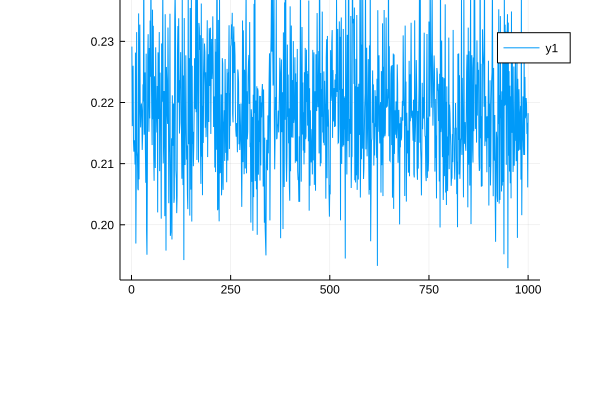

GKS: 


In [40]:
ampl_data = chn[:ampl].value.data
print(mean(ampl_data[:,1,1]))
plot(ampl_data[:,1,1])

In [41]:
r_data = chn[:r].value.data
r_mean=mean(r_data,dims=1)[1,:,1]

1002-element Array{Real,1}:
  0.8301577387380595 
  0.8809880677635925 
  0.9356290042764289 
  0.9193223961386663 
  0.814135555944766  
  0.6290022283889792 
  0.4617080603543022 
  0.446073567636141  
  0.23322428957880403
  0.12479612190508715
  0.1743662587300972 
  0.24427705367403313
  0.3058964575590008 
  ⋮                  
 -0.0739245383077013 
 -0.09798016570911028
 -0.02207418839687753
  0.1794865039282321 
  0.33646418346964135
  0.5058939532663882 
  0.6248065245150239 
  0.7472987978118467 
  0.8170239536089368 
  0.7650367597285588 
  0.6105220581327834 
  0.3734902181252634 

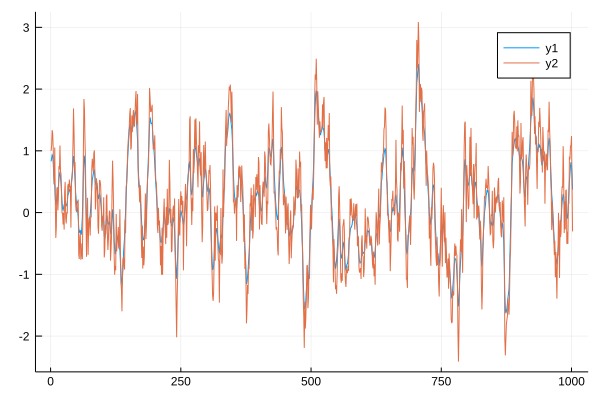

In [42]:
plot(r_mean)
plot!(sol.u)

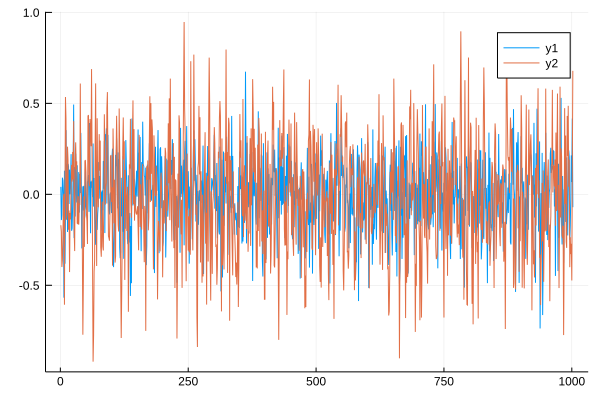

In [43]:
plot(noise)
plot!(r_mean.-sol.u)